### Imports

In [2]:
from data_functions import get_LSTM_SSA, get_LAMP_SSA, get_SC_SSA
import copy
import os
import logging
import traceback

# sys.path.insert(1, "H:\\OneDrive - Massachusetts Institute of Technology\\Thesis\\SimpleCode_to_LAMP_LSTM")

import torch
import numpy as np
import matplotlib.pyplot as plt
import random
import time
from torch import nn
from torch.nn import functional as F
from torch.utils.data import DataLoader
from torch.utils.data import Dataset
from plot_lstm_results import plot_lstm_results
from network_models import LSTM
from train_test import train, test
from S2LDataset import S2LDataset
from print_error_report import print_error_report
from objective_functions import objective_function

# On the line below, specifiy after "from" which file the user inputs are coming from.
from input_template import (
    UserInputArgs,
    PlottingArgs,
    DataInfoArgs,
    SaveDataArgs,
    DerivedArgs,
)
from load_and_standardize import load_and_standardize
from reshape_for_time_resolution import reshape_for_time_resolution, reshape_full_series
from save_lstm import save_lstm_info, load_lstm_info
from save_lstm_results import save_lstm_results, save_lstm_test_results
from unstandardize_all_data import unstandardize_all_data

import matplotlib_inline.backend_inline
matplotlib_inline.backend_inline.set_matplotlib_formats('svg')
import matplotlib.pyplot as plt

### Description
Create and train Bimodal LSTMS 50 samples from their bucket.  Compare to the TL MED LSTMS where each MED LSTM was fed 50 records, randomly selected.

### Functions

In [3]:
print("Cuda available:", torch.cuda.is_available())
if torch.cuda.is_available():
    torch.cuda.empty_cache()  # to avoid some rare errors.

# Check if using CPU or GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Set parameters
args = UserInputArgs()
plot_args = PlottingArgs()
data_info_args = DataInfoArgs()
save_data_args = SaveDataArgs()

# args.training_mode = False

# Load original LSTM
# args.model_load_filename = 'MED2_30'
# network, std_factors = load_lstm_info(args)
# network.to(device)

Cuda available: True


In [4]:
def create_and_train_LSTM(experiment='', N=50):
    '''Create, train, and save a new LSTM on bimodal test sets.  Train on N randomly selected records for each bucket.'''

    # ID Experiment for tracking
    print("EXPERIMENT: ", experiment)

    # Setup GPU Support
    print("Cuda available:", torch.cuda.is_available())
    if torch.cuda.is_available():
        torch.cuda.empty_cache()  # to avoid some rare errors.

    # Check if using CPU or GPU
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # Set parameters
    args = UserInputArgs()
    plot_args = PlottingArgs()
    data_info_args = DataInfoArgs()
    save_data_args = SaveDataArgs()

    # Create list of eligible files to train on
    # exp_PATH = f'H:\\OneDrive - Massachusetts Institute of Technology\\Thesis\\SimpleCode_to_LAMP_LSTM\\Experiment_ARCHIVE\\Bimodal Test Sets\\{experiment}'
    exp_PATH = f'H:\\OneDrive - Massachusetts Institute of Technology\\Thesis\\SimpleCode_to_LAMP_LSTM\\Experiment_ARCHIVE\\{experiment}'
    files = [f for f in os.listdir(exp_PATH + '\\LAMP_files') if f.endswith('1.mot')]

    # randomly select N num_files to train on
    train_files = np.random.choice(files, size=N, replace = False)
    val_files = [f.replace('1.mot','2.mot') for f in train_files]

    # Shorten val_files to 20% of train_files, randomly selected
    val_files = np.random.choice(val_files, size=int(.2*len(val_files)), replace = False)

    # establish the lamp and sc training file paths
    data_info_args.train_lamp = [exp_PATH + '\\LAMP_files\\' + f.removesuffix('.mot') for f in train_files]
    data_info_args.train_sc = [exp_PATH + '\\SimpleCode_files\\' + f.replace('LAMP','SC').removesuffix('.mot') for f in train_files]

    # establish the lamp and sc validation file paths
    data_info_args.val_lamp= [exp_PATH + '\\LAMP_files\\' + f.removesuffix('.mot') for f in val_files]
    data_info_args.val_sc = [exp_PATH + '\\SimpleCode_files\\' + f.replace('LAMP','SC').removesuffix('.mot') for f in val_files]

    # Setup Derived Args
    derived_args = DerivedArgs(args, data_info_args)

    # Read in and standardize the training and validation data
    train_input, train_target, std_factors, train_sc = load_and_standardize(data_info_args.train_sc, data_info_args.train_lamp, args, std_factors=[])
    val_input, val_target, val_sc = load_and_standardize(data_info_args.val_sc, data_info_args.val_lamp, args, std_factors)

    print('Std_factors: ', std_factors)

    # Create the LSTM
    network = LSTM(args.input_size,args.hidden_size,args.num_layers,args.output_size,args.bi_directional,args.dropout,).to(device)

    # Update the save path
    args.model_save_filename = exp_PATH + f'\\{experiment}_BiMod_{N}_LSTM'

    # Reshape the data to take into account the time resolution
    train_input, train_target = reshape_for_time_resolution(train_input, train_target, args)
    val_input, val_target = reshape_for_time_resolution(val_input, val_target, args)

    # Create Dataset objects for each of our train/val/test sets
    train_dataset = S2LDataset(train_input, train_target)
    val_dataset = S2LDataset(val_input, val_target)

    # Create a PyTorch dataloader for each train/val set. Test set isn't needed until later
    train_loader = DataLoader(train_dataset, batch_size=derived_args.train_batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=derived_args.val_batch_size)

    # Display realization and batch numbers
    print("No of train realizations: ", derived_args.num_train_realizations)
    print("No of val realizations: ", derived_args.num_val_realizations)
    print("No of test realizations: ", derived_args.num_test_realizations)
    print("No of realizations: ", derived_args.num_realizations)
    print("Train batch size: ", derived_args.train_batch_size)
    realization_length = train_input.shape[1] * args.time_res

    # initialize our optimizer. We'll use Adam
    optimizer = torch.optim.Adam(network.parameters(), lr=args.lr)

    # Begin Training
    best_val_loss = float("inf")
    best_loss_counter = 0
    print("\n Beginning Training")
    start_time = time.time()
    for epoch in range(1, args.epochs + 1):
        train_loss = train(network, device, train_loader, optimizer, args.train_fun_hyp)
        val_loss = test(network, device, val_loader, args.val_fun_hyp)
        if val_loss < 0.95 * best_val_loss:
            best_val_loss = val_loss
            best_loss_counter = 0
            torch.save(network.state_dict(), "recently_trained_model.pt")
        else:
            best_loss_counter += 1
        if best_loss_counter > 30:
            break
        print("Train Epoch: {:02d} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f} \tCounter: {:02d}".format(epoch, train_loss, val_loss, best_loss_counter))
    print("Training Done\n")
    end_time = time.time()
    trainTime = end_time - start_time
    print("Training Time: ", trainTime)

    # restoring the best found network based on validation data
    network.load_state_dict(torch.load("recently_trained_model.pt"))

    # Save the LSTM
    save_lstm_info(network.state_dict(), args, data_info_args, std_factors)

    # Return the Training time
    return trainTime
    print('\n\n')


In [5]:
t = create_and_train_LSTM('MED LSTM',N=81)

EXPERIMENT:  MED LSTM
Cuda available: True
full series simple (input) shape  (81, 17990, 4)
full series lamp (target) shape  (81, 17990, 3)
full series simple (input) shape  (16, 17990, 4)
full series lamp (target) shape  (16, 17990, 3)
Std_factors:  [2.0746180605023876, 1.62943534593359, 0.1404279107954979, 5.2040565988301095, -0.050599503490992445, 1.3636876174688388, -0.0011057141072958563, 1.875388099394071, 1.9068784990921137, 1.6455536069097387, -0.03658747605573499, 7.050090569617568, 0.036665034949317755, 1.9982143742210599]
No of train realizations:  81
No of val realizations:  16
No of test realizations:  81
No of realizations:  178
Train batch size:  7

 Beginning Training
Train Epoch: 01 	Training Loss: 0.248385 	Validation Loss: 0.055522 	Counter: 00
Train Epoch: 02 	Training Loss: 0.043784 	Validation Loss: 0.044577 	Counter: 00
Train Epoch: 03 	Training Loss: 0.032268 	Validation Loss: 0.029697 	Counter: 00
Train Epoch: 04 	Training Loss: 0.025272 	Validation Loss: 0.025

In [3]:
PATH = f'H:\\OneDrive - Massachusetts Institute of Technology\\Thesis\\SimpleCode_to_LAMP_LSTM\\Experiment_ARCHIVE\\Bimodal Test Sets\\'
ignore = ['Cases_files', '.ipynb_checkpoints','SecAngleOnly_test','__pycache__']
t = []
exp_list = []
for exp in os.listdir(PATH):
    if os.path.isdir(PATH + exp) and exp not in ignore:
        try:
            t.append(create_and_train_LSTM(exp,N=50))
            exp_list.append(exp)
        except Exception as e:
            logging.error(traceback.format_exc())
            print('ERROR in ', exp)
            print('\n\n\n\n')
            continue

EXPERIMENT:  aavs
Cuda available: True
full series simple (input) shape  (50, 17990, 4)
full series lamp (target) shape  (50, 17990, 3)
full series simple (input) shape  (10, 17990, 4)
full series lamp (target) shape  (10, 17990, 3)
Std_factors:  [2.0817947068570866, 1.785398915158155, 0.1357989731730586, 5.208764295646098, -0.04988357570164828, 1.4401089309543083, -0.002445807048502605, 2.0241080276529306, 1.8862470412054213, 1.828894508132582, -0.0001605073510437198, 7.290243442531789, 0.036345374038982026, 2.095754081965162]
No of train realizations:  50
No of val realizations:  10
No of test realizations:  81
No of realizations:  141
Train batch size:  5

 Beginning Training
Train Epoch: 01 	Training Loss: 0.334947 	Validation Loss: 0.092454 	Counter: 00
Train Epoch: 02 	Training Loss: 0.090461 	Validation Loss: 0.066364 	Counter: 00
Train Epoch: 03 	Training Loss: 0.070551 	Validation Loss: 0.049386 	Counter: 00
Train Epoch: 04 	Training Loss: 0.054204 	Validation Loss: 0.045445 	

ERROR:root:Traceback (most recent call last):
  File "C:\Users\jarod\AppData\Local\Temp\ipykernel_33288\2068697412.py", line 8, in <module>
    t.append(create_and_train_LSTM(exp,N=50))
  File "C:\Users\jarod\AppData\Local\Temp\ipykernel_33288\3351547683.py", line 26, in create_and_train_LSTM
    train_files = np.random.choice(files, size=N, replace = False)
  File "mtrand.pyx", line 915, in numpy.random.mtrand.RandomState.choice
ValueError: 'a' cannot be empty unless no samples are taken



Training Done

Training Time:  329.4605531692505
Saving this newly trained model and info in:  H:\OneDrive - Massachusetts Institute of Technology\Thesis\SimpleCode_to_LAMP_LSTM\Experiment_ARCHIVE\Bimodal Test Sets\ppvs\ppvs_BiMod_50_LSTM .pickle
EXPERIMENT:  pva
Cuda available: True
ERROR in  pva





EXPERIMENT:  pvaa
Cuda available: True
full series simple (input) shape  (50, 17990, 4)
full series lamp (target) shape  (50, 17990, 3)
full series simple (input) shape  (10, 17990, 4)
full series lamp (target) shape  (10, 17990, 3)
Std_factors:  [2.0869374834634535, 1.7261125493760168, 0.11558871779779566, 5.061091286383259, -0.05343283227860376, 1.448187213228055, -0.002717186532799998, 2.0195136773625437, 1.8964430698261054, 1.741295675092401, 0.043627373760954824, 7.222984318996497, 0.036448163763670674, 2.0891348872563476]
No of train realizations:  50
No of val realizations:  10
No of test realizations:  81
No of realizations:  141
Train batch size:  5

 Beginning Training
Train Ep

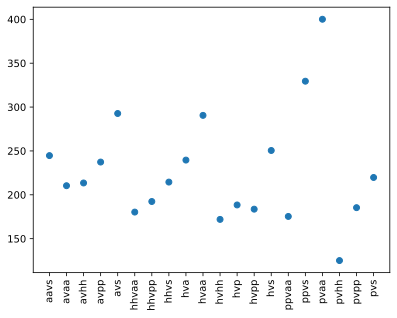

In [4]:
plt.plot(exp_list,t,'o')
plt.xticks(rotation=90)
plt.ylabel('Time (s)')
plt.xlabel('Experiment')
plt.title('Training Time for New LSTMs in Bimodal Seas')
plt.show()

In [2]:
def generate_test_output(experiment='', N=50, save_folder=''):
    """Given an experiment generate and save output files"""
    
    # ID Experiment for tracking
    print("EXPERIMENT: ", experiment)

    exp_PATH = f'H:\\OneDrive - Massachusetts Institute of Technology\\Thesis\\SimpleCode_to_LAMP_LSTM\\Experiment_ARCHIVE\\Bimodal Test Sets\\{experiment}'

    # Setup GPU Support
    print("Cuda available:", torch.cuda.is_available())
    if torch.cuda.is_available():
        torch.cuda.empty_cache()  # to avoid some rare errors.

    # Check if using CPU or GPU
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # Set parameters
    args = UserInputArgs()
    data_info_args = DataInfoArgs()
    save_data_args = SaveDataArgs()

    # Load the LSTM
    args.model_load_filename = exp_PATH + f'\\{experiment}_BiMod_{N}_LSTM'
    network, std_factors = load_lstm_info(args)
    network.to(device)

    # Create list of eligible files to train on
    test_files = [f for f in os.listdir(exp_PATH + '\\LAMP_files') if f.endswith('3.mot')]

    # test_files = files
    data_info_args.test_lamp = [exp_PATH + '\\LAMP_files\\' + f.removesuffix('.mot') for f in test_files]
    data_info_args.test_sc = [exp_PATH + '\\SimpleCode_files\\' + f.replace('LAMP','SC').removesuffix('.mot') for f in test_files]

    # Setup Derived Args
    derived_args = DerivedArgs(args, data_info_args)
    derived_args.test_batch_size = int(derived_args.num_test_realizations * args.time_res / 9)
    # print("No of train realizations: ", derived_args.num_train_realizations)
    # print("No of val realizations: ", derived_args.num_val_realizations)
    print("No of test realizations: ", derived_args.num_test_realizations)
    # print("No of realizations: ", derived_args.num_realizations)
    # print("Train batch size: ", derived_args.train_batch_size)
    # print("Val batch size: ", derived_args.val_batch_size)
    print("Test batch size: ", derived_args.test_batch_size)

    # Load the training and validation data
    test_input, test_target, test_sc = load_and_standardize(data_info_args.test_sc, data_info_args.test_lamp, args, std_factors)

    # Reshape the data to take into account the time resolution
    test_input, test_target = reshape_for_time_resolution(test_input, test_target, args)

    # Create Dataset objects for each of our train/val/test sets
    test_dataset = S2LDataset(test_input, test_target)

    # Create testing dataloader
    test_loader = DataLoader(test_dataset, batch_size=derived_args.test_batch_size)

    # Display dataset information
    # print("\nReshaped the following data:")
    # print(f"train_input has shape	{train_input.shape}")
    # print(f"train_target has shape	{train_target.shape}")
    # print(f"val_input has shape 	{val_input.shape}")
    # print(f"val_target has shape 	{val_target.shape}")
    print(f"test_input has shape 	{test_input.shape}")
    print(f"test_target has shape 	{test_target.shape}")
    # realization_length = train_input.shape[1] * args.time_res

    # initialize our optimizer. We'll use Adam
    optimizer = torch.optim.Adam(network.parameters(), lr=args.lr)

    start_time = time.time()
    test_lstm_output = test(network,device,test_loader,args.val_fun_hyp,derived_args.num_test_realizations,args.time_res,True,)
    end_time = time.time()
    testTime = end_time - start_time
    print("Testing Time: ", testTime)
    # print("\ntrain output shape", train_lstm_output.shape)
    # print("val output shape  ", val_lstm_output.shape)
    print("test output shape ", test_lstm_output.shape)
    print("Time to produce output for ",derived_args.num_realizations," realizations:",(end_time - start_time),)

    # Reshape our input and targets to be same shape as output
    # train_input, train_target, train_lstm_output = reshape_full_series(train_input, train_target, train_lstm_output, args)
    # val_input, val_target, val_lstm_output = reshape_full_series(val_input, val_target, val_lstm_output, args)
    test_input, test_target, test_lstm_output = reshape_full_series(test_input, test_target, test_lstm_output, args)

    # Unstandardize
    # train_target, train_lstm_output = unstandardize_all_data(train_target, train_lstm_output, std_factors, args)
    # val_target, val_lstm_output = unstandardize_all_data(val_target, val_lstm_output, std_factors, args)
    test_target, test_lstm_output = unstandardize_all_data(test_target, test_lstm_output, std_factors, args)

    # # Print error report
    # print("\nLSTM Error Results:")
    # print_error_report(train_lstm_output,val_lstm_output,test_lstm_output,train_target,val_target,test_target,args,)
    
    # Save the output
    save_data_args.test = list(range(0,len(data_info_args.test_sc)))
    save_data_args.output_path = exp_PATH + f'\\{save_folder}\\'
    print("Saving output to ",save_data_args.output_path)
    save_lstm_test_results(test_lstm_output,save_data_args,data_info_args,args,std_factors,)
    print('')

In [3]:
PATH = f'H:\\OneDrive - Massachusetts Institute of Technology\\Thesis\\SimpleCode_to_LAMP_LSTM\\Experiment_ARCHIVE\\Bimodal Test Sets\\'
ignore = ['Cases_files', '.ipynb_checkpoints','SecAngleOnly_test','__pycache__']
for exp in os.listdir(PATH):
    if os.path.isdir(PATH + exp) and exp not in ignore:
        try:
            generate_test_output(exp,N=50,save_folder='output_files_BiMod2_30_50')
        except Exception as e:
            logging.error(traceback.format_exc())
            print('ERROR in ', exp)
            print('\n\n\n')
            continue

EXPERIMENT:  aavs
Cuda available: True
Loading LSTM Saved in:  H:\OneDrive - Massachusetts Institute of Technology\Thesis\SimpleCode_to_LAMP_LSTM\Experiment_ARCHIVE\Bimodal Test Sets\aavs\aavs_BiMod_50_LSTM .pickle
No of test realizations:  216
Test batch size:  216
full series simple (input) shape  (216, 17990, 4)
full series lamp (target) shape  (216, 17990, 3)
test_input has shape 	(1944, 1998, 4)
test_target has shape 	(1944, 1998, 3)
Testing Time:  1.1020019054412842
test output shape  (1944, 1998, 3)
Time to produce output for  378  realizations: 1.1020019054412842
Saving output to  H:\OneDrive - Massachusetts Institute of Technology\Thesis\SimpleCode_to_LAMP_LSTM\Experiment_ARCHIVE\Bimodal Test Sets\aavs\output_files_BiMod2_30_50\

EXPERIMENT:  avaa
Cuda available: True
Loading LSTM Saved in:  H:\OneDrive - Massachusetts Institute of Technology\Thesis\SimpleCode_to_LAMP_LSTM\Experiment_ARCHIVE\Bimodal Test Sets\avaa\avaa_BiMod_50_LSTM .pickle
No of test realizations:  288
Test b

ERROR:root:Traceback (most recent call last):
  File "C:\Users\jarod\AppData\Local\Temp\ipykernel_15232\1277070756.py", line 6, in <module>
    generate_test_output(exp,N=50,save_folder='output_files_BiMod2_30_50')
  File "C:\Users\jarod\AppData\Local\Temp\ipykernel_15232\251241938.py", line 46, in generate_test_output
    test_input, test_target, test_sc = load_and_standardize(data_info_args.test_sc, data_info_args.test_lamp, args, std_factors)
  File "h:\OneDrive - Massachusetts Institute of Technology\Thesis\SimpleCode_to_LAMP_LSTM\load_and_standardize.py", line 48, in load_and_standardize
    lstm_inputs, target_outputs = load_fullseries(
  File "h:\OneDrive - Massachusetts Institute of Technology\Thesis\SimpleCode_to_LAMP_LSTM\load_and_standardize.py", line 38, in load_fullseries
    np.concatenate((simple_vbm_data, simple_motion_data, wave_data), axis=1)
  File "<__array_function__ internals>", line 180, in concatenate
ValueError: all the input array dimensions for the concatenat

ERROR in  hvp




EXPERIMENT:  hvpp
Cuda available: True
Loading LSTM Saved in:  H:\OneDrive - Massachusetts Institute of Technology\Thesis\SimpleCode_to_LAMP_LSTM\Experiment_ARCHIVE\Bimodal Test Sets\hvpp\hvpp_BiMod_50_LSTM .pickle
No of test realizations:  81
Test batch size:  81
full series simple (input) shape  (81, 17990, 4)
full series lamp (target) shape  (81, 17990, 3)
test_input has shape 	(729, 1998, 4)
test_target has shape 	(729, 1998, 3)
Testing Time:  0.2819991111755371
test output shape  (729, 1998, 3)
Time to produce output for  243  realizations: 0.2819991111755371
Saving output to  H:\OneDrive - Massachusetts Institute of Technology\Thesis\SimpleCode_to_LAMP_LSTM\Experiment_ARCHIVE\Bimodal Test Sets\hvpp\output_files_BiMod2_30_50\

EXPERIMENT:  hvs
Cuda available: True
Loading LSTM Saved in:  H:\OneDrive - Massachusetts Institute of Technology\Thesis\SimpleCode_to_LAMP_LSTM\Experiment_ARCHIVE\Bimodal Test Sets\hvs\hvs_BiMod_50_LSTM .pickle
No of test realizations:  81

ERROR:root:Traceback (most recent call last):
  File "C:\Users\jarod\AppData\Local\Temp\ipykernel_15232\1277070756.py", line 6, in <module>
    generate_test_output(exp,N=50,save_folder='output_files_BiMod2_30_50')
  File "C:\Users\jarod\AppData\Local\Temp\ipykernel_15232\251241938.py", line 24, in generate_test_output
    network, std_factors = load_lstm_info(args)
  File "h:\OneDrive - Massachusetts Institute of Technology\Thesis\SimpleCode_to_LAMP_LSTM\save_lstm.py", line 23, in load_lstm_info
    loaded_lstm = pickle.load(open(user_input_args.model_load_filename+".pickle", "rb"))
FileNotFoundError: [Errno 2] No such file or directory: 'H:\\OneDrive - Massachusetts Institute of Technology\\Thesis\\SimpleCode_to_LAMP_LSTM\\Experiment_ARCHIVE\\Bimodal Test Sets\\pva\\pva_BiMod_50_LSTM.pickle'




EXPERIMENT:  pva
Cuda available: True
Loading LSTM Saved in:  H:\OneDrive - Massachusetts Institute of Technology\Thesis\SimpleCode_to_LAMP_LSTM\Experiment_ARCHIVE\Bimodal Test Sets\pva\pva_BiMod_50_LSTM .pickle
ERROR in  pva




EXPERIMENT:  pvaa
Cuda available: True
Loading LSTM Saved in:  H:\OneDrive - Massachusetts Institute of Technology\Thesis\SimpleCode_to_LAMP_LSTM\Experiment_ARCHIVE\Bimodal Test Sets\pvaa\pvaa_BiMod_50_LSTM .pickle
No of test realizations:  216
Test batch size:  216
full series simple (input) shape  (216, 17990, 4)
full series lamp (target) shape  (216, 17990, 3)
test_input has shape 	(1944, 1998, 4)
test_target has shape 	(1944, 1998, 3)
Testing Time:  1.0389995574951172
test output shape  (1944, 1998, 3)
Time to produce output for  378  realizations: 1.0389995574951172
Saving output to  H:\OneDrive - Massachusetts Institute of Technology\Thesis\SimpleCode_to_LAMP_LSTM\Experiment_ARCHIVE\Bimodal Test Sets\pvaa\output_files_BiMod2_30_50\

EXPERIMENT:  pvhh
Cu

In [3]:
def LSTMvLAMP_df(experiment="",LSTM_files='', realization=''):
    
    from pathlib import Path
    import pandas as pd

    """Makes a dataframe comparing LSTM and LAMP outputs
        experiment = folder name of the experiment"""

    # Establish paths
    exp_PATH = f'H:\\OneDrive - Massachusetts Institute of Technology\\Thesis\\SimpleCode_to_LAMP_LSTM\\Experiment_ARCHIVE\\Bimodal Test Sets\\{experiment}\\'

    # network options
    # nwOptions = ('original', 'new')
    
    # No experiment or network given
    if experiment == "" or LSTM_files == '':
        return "INVALID EXPERIMENT OR NETWORK"

    # Parse out the variables observed
    v1 = experiment.partition("v")[0]  # Pulls first variable by taking string before "_", spliting at the "v"
    v2 = experiment.partition("v")[2]  # 2nd variable

    # LAMP path
    LAMP_path = exp_PATH + "\\LAMP_files\\"

    # LSTM data
    exp_PATH += LSTM_files + '\\'

    # Set experiment path
    # if network.lower() == "original":
    #     exp_PATH += "\\output_files_MED\\"
    # elif network.lower() == "new":
    #     exp_PATH += "\\output_files_MED2_30_50\\"

    # Make the dataframe for LSTM
    df_LSTM = pd.DataFrame(
        columns=[v1, v2, "Zcg", "Roll", "Pitch"]
    )  # Create cols for the altered variables in experiement and heave, roll, pitch

    # step through every LSTM file in the experiement to get the SSA, and add to dataframe
    for path in Path(exp_PATH).glob(f"*{realization}.txt"):
        # Get the SSA's
        SSA = get_LSTM_SSA(path)
        # Get the variable combo for the file
        trial = path.name.lstrip("lstm_output_for_SC_")
        idx = trial.partition(v1)[2]
        t1 = idx.partition("_")[0]
        if v2 == "s":
            idx = trial.partition(v2)[2]
            t2 = idx.partition("-")[0]
        else:
            idx = trial.partition(v2)[2]
            t2 = idx.partition("_")[0]

        SSA[v1] = float(t1)
        SSA[v2] = float(t2)

        df_LSTM.loc[len(df_LSTM)] = SSA

    df_LSTM = df_LSTM.sort_values(by=[v1, v2])

    # Make the dataframe for LAMP
    df_LAMP = pd.DataFrame(columns=[v1, v2, "Zcg", "Roll", "Pitch"])

    # step through every LAMP file in the experiement to get the SSA, and add to dataframe
    for path in Path(LAMP_path).glob(f"*{realization}.mot"):
        # Get the SSA's
        SSA = get_LAMP_SSA(path)
        # Get the variable combo for the file
        trial = path.name.lstrip("LAMP_")
        idx = trial.partition(v1)[2]
        t1 = idx.partition("_")[0]
        if v2 == "s":
            idx = trial.partition(v2)[2]
            t2 = idx.partition("-")[0]
        else:
            idx = trial.partition(v2)[2]
            t2 = idx.partition("_")[0]

        SSA[v1] = float(t1)
        SSA[v2] = float(t2)

        df_LAMP.loc[len(df_LAMP)] = SSA

    df_LAMP = df_LAMP.sort_values(by=[v1, v2])

    # Establish new, final DF for heatmap
    df_final = pd.DataFrame(columns=[v1, v2, "Zcg Error", "Roll Error", "Pitch Error"])
    df_final[v1] = df_LSTM[v1]
    df_final[v2] = df_LSTM[v2]

    # find the absolute difference between each in the series
    df_final["Zcg Error"] = np.abs(df_LSTM["Zcg"] - df_LAMP["Zcg"])
    df_final["Roll Error"] = np.abs(df_LSTM["Roll"] - df_LAMP["Roll"])
    df_final["Pitch Error"] = np.abs(df_LSTM["Pitch"] - df_LAMP["Pitch"])

    return df_final, v1, v2

In [4]:
def makeHeatmap(experiment, parameter, realization):
    import seaborn as sns
    """
    Creates a heatmap of SSA error between unimodal LSTM and same LSTM trained with bimodal seas. Given a df of the form:
    v1      v2    Zcg Error       Roll Error    Pitch Error
    experiment = case file
    network = network trained on
    parameter = parameter we want to see
    """

    # Set save path for the figure
    SAVE_PATH = 'H:\\OneDrive - Massachusetts Institute of Technology\\Thesis\\SimpleCode_to_LAMP_LSTM\\Experiment_ARCHIVE\\Transfer Learning Figures\\TL50_vs_BiMod50'

    # Set units for color bar
    if parameter == "Zcg Error":
        units = "meters"
    else:
        units = "degrees"

    # Set the fig and ax
    fig, (axo, axn, axd) = plt.subplots(3, figsize=(16, 16), sharey=True)
    cbar_ax = fig.add_axes([0.91, 0.3, 0.03, 0.4])
    fig.suptitle(f"{experiment} Absolute SSA {parameter}", fontsize=18)

    # get the Original dataset
    dfo, v1, v2 = LSTMvLAMP_df(experiment, 'output_files_BiMod2_30_50', realization)
    resulto = dfo.pivot(index=v2, columns=v1, values=parameter)

    # Set colorbar max value
    vmax = resulto.max().max()

    # get the new dataset
    dfn, v1, v2 = LSTMvLAMP_df(experiment, 'output_files_MED2_30_50', realization)
    resultn = dfn.pivot(index=v2, columns=v1, values=parameter)

    # Set colorbar max value to that of new if it's more than med
    if resultn.max().max() > vmax:
        vmax = resultn.max().max()

    # Plot original dataset
    g1 = sns.heatmap(
        resulto,cmap="Blues",ax=axo,cbar_kws={"label": units},cbar=True,vmax=vmax,cbar_ax=cbar_ax, annot = True, fmt = ".2f"
    )
    g1.invert_yaxis()
    g1.set_title("Bimodal Training")

    # get the new dataset
    g2 = sns.heatmap(
        resultn, cmap="Blues", ax=axn, cbar=True, vmax=vmax, cbar_ax=cbar_ax, annot = True, fmt = ".2f"
    )
    g2.invert_yaxis()
    g2.set_title("Transfer Learning")

    # Plot a heatmap comparing the difference between the two.  Bigger is better b/c delta_orig - delta_new means new performed much better
    dfc = dfn.copy()
    cols =  dfo.columns.difference([v1,v2])
    dfc[cols] = dfo[cols] - dfn[cols]
    resultc = dfc.pivot(index=v2, columns=v1, values=parameter)
    g3 = sns.heatmap(
        resultc, cmap="Blues", ax=axd, cbar=True, vmax=vmax, cbar_ax=cbar_ax, annot = True, fmt = ".2f"
    )
    g3.invert_yaxis()
    g3.set_title("Delta")

    # Save the figure
    plt.savefig(f"{SAVE_PATH}\\{experiment}_TL50_vs_BiMod50_{parameter}_{realization}.png")


### Testing HeatMaps

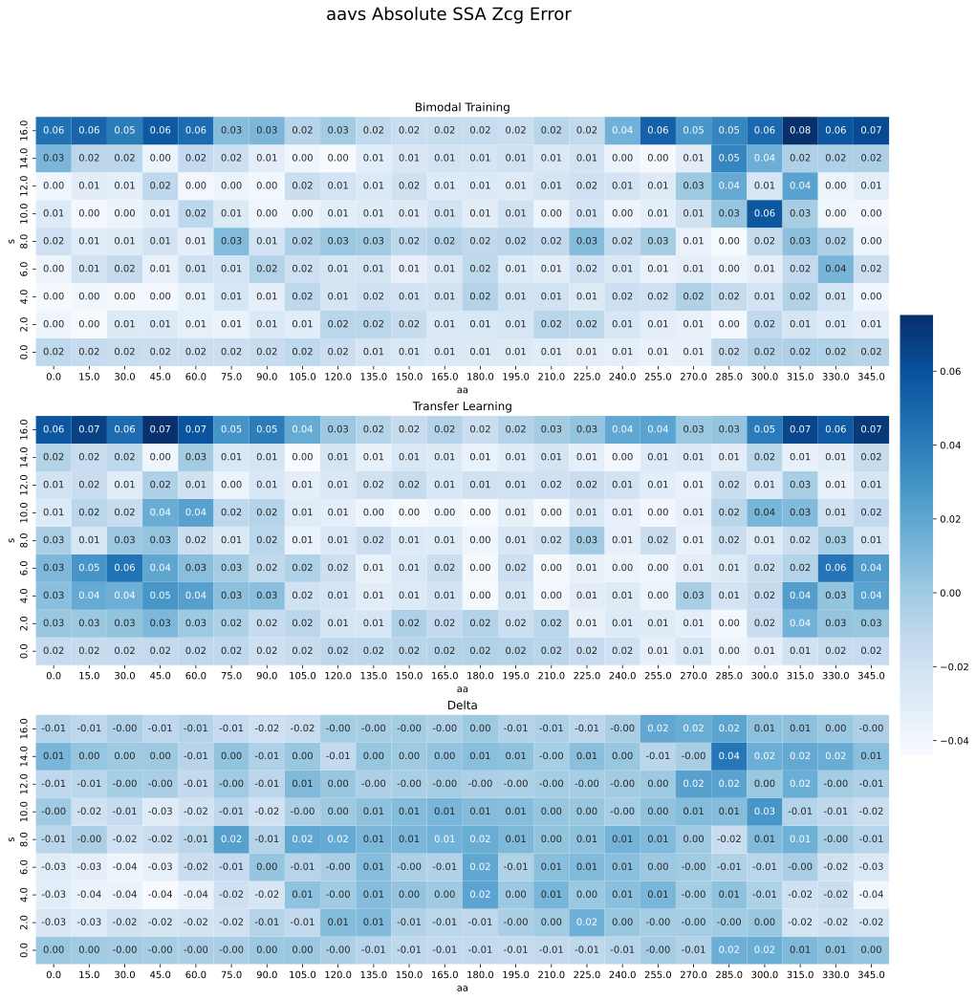

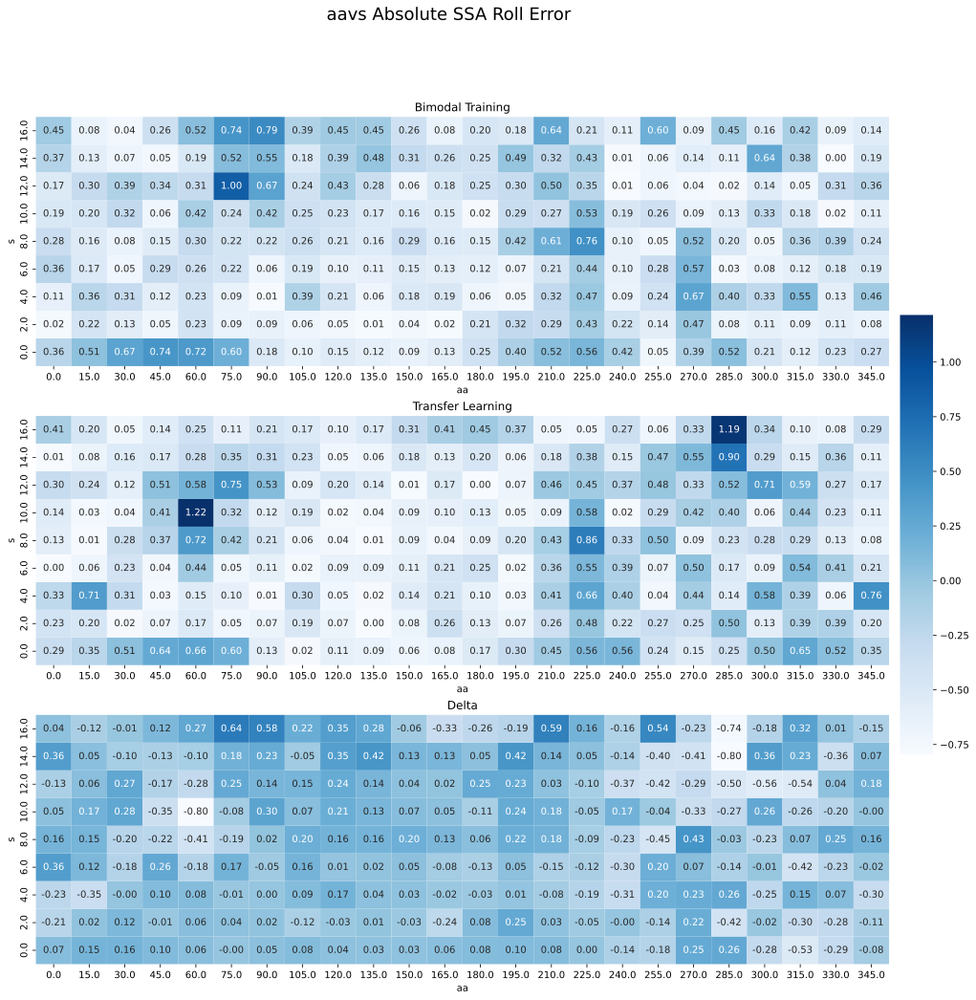

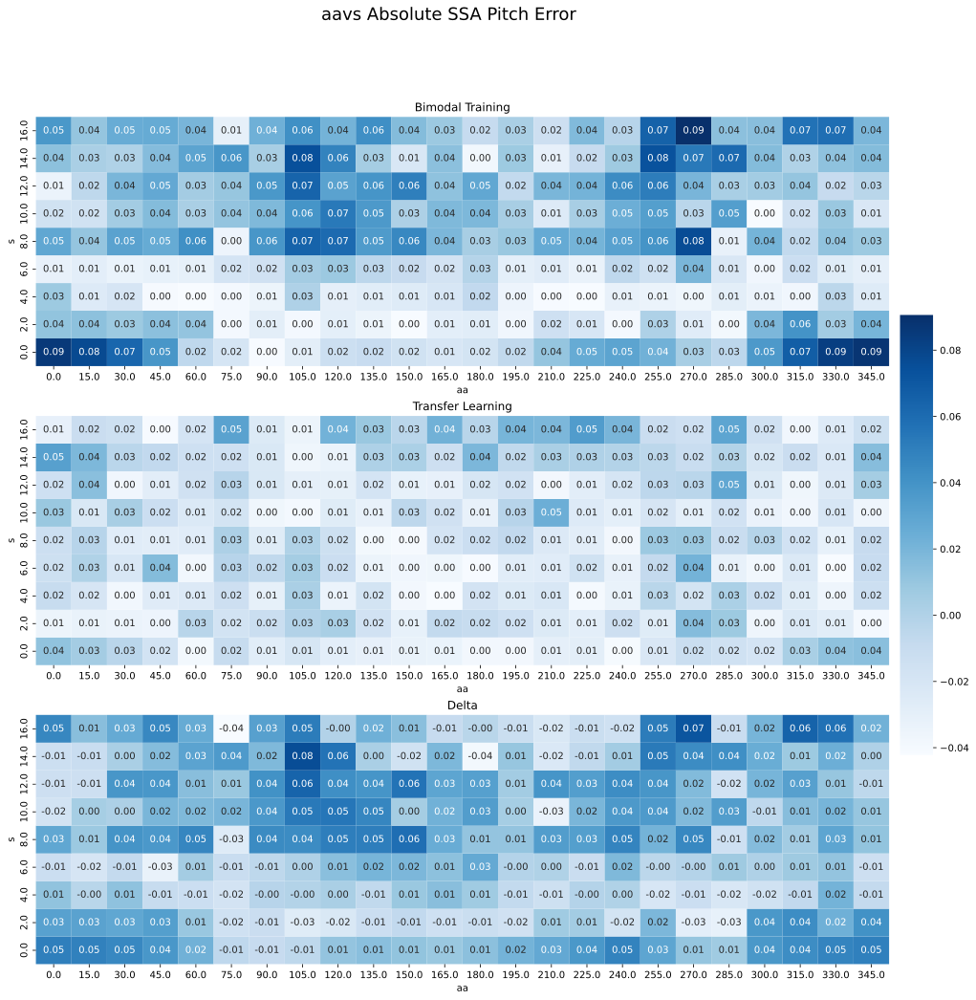

In [5]:
try:
    makeHeatmap('aavs', "Zcg Error", '3')
    makeHeatmap('aavs', "Roll Error", '3')
    makeHeatmap('aavs', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())

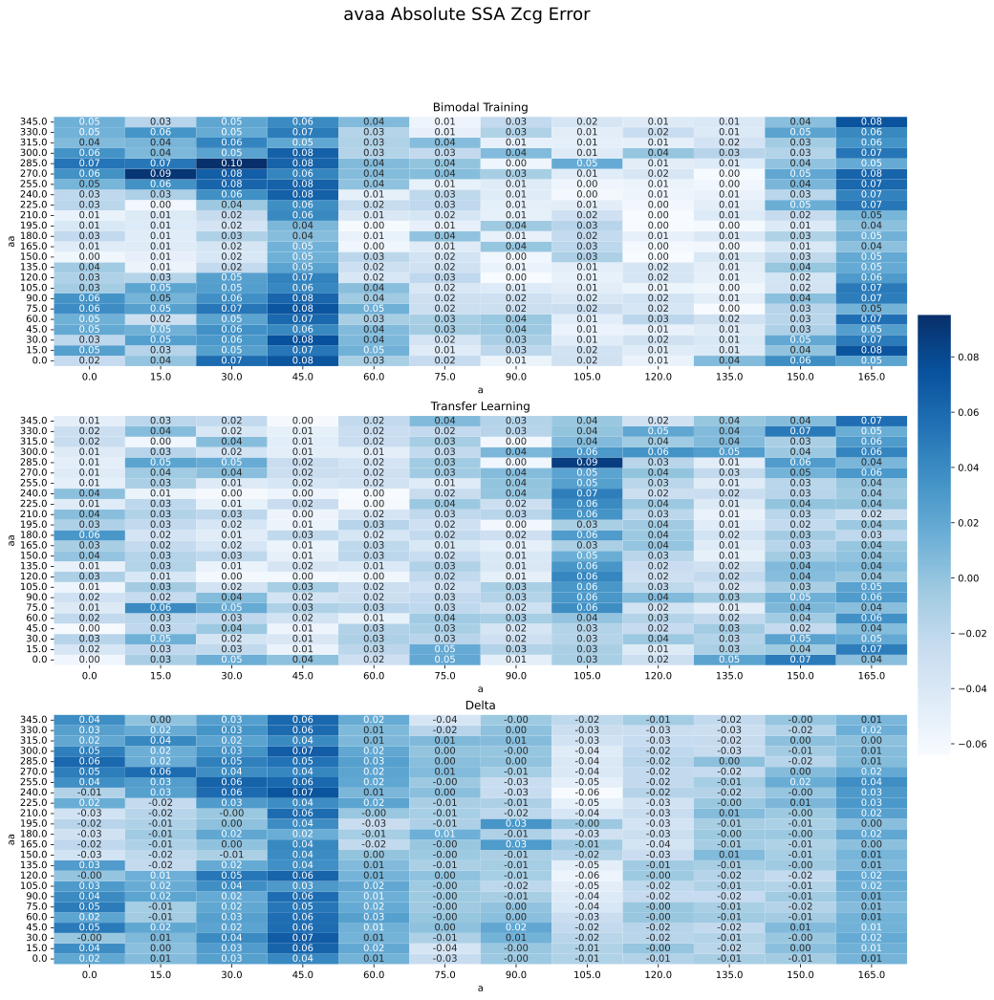

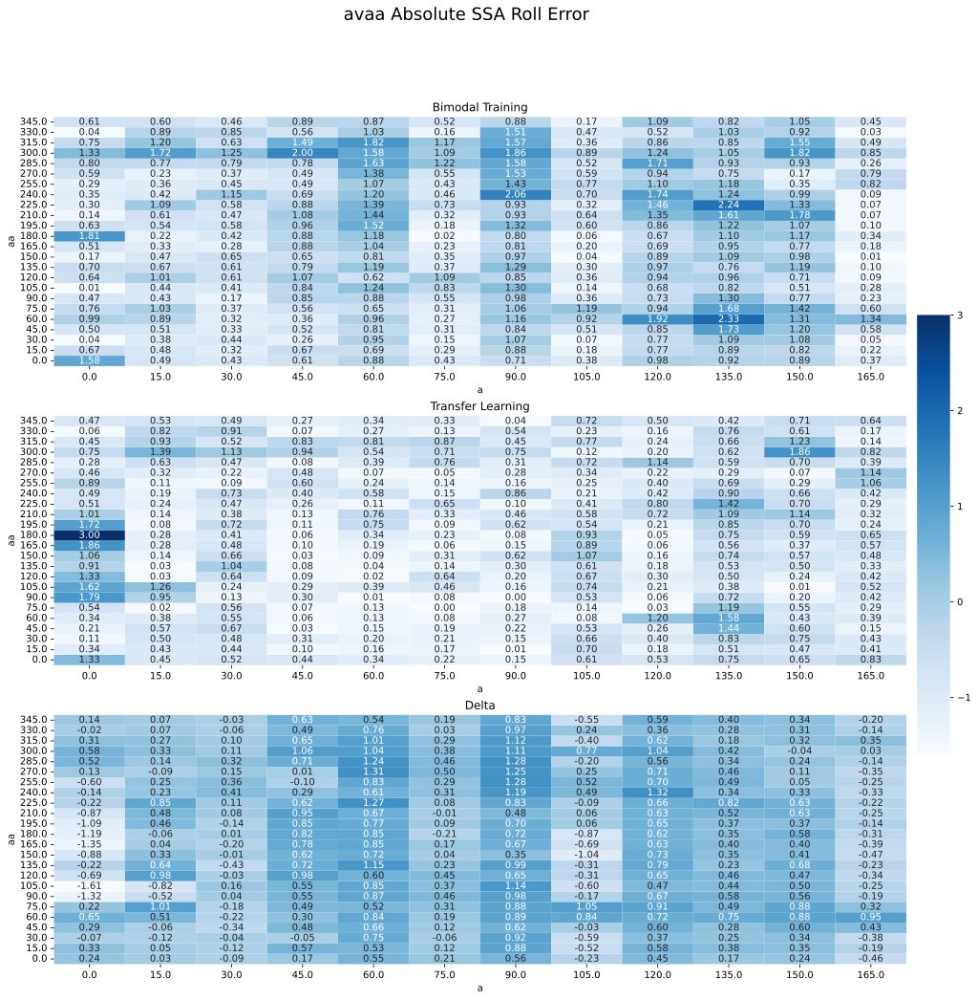

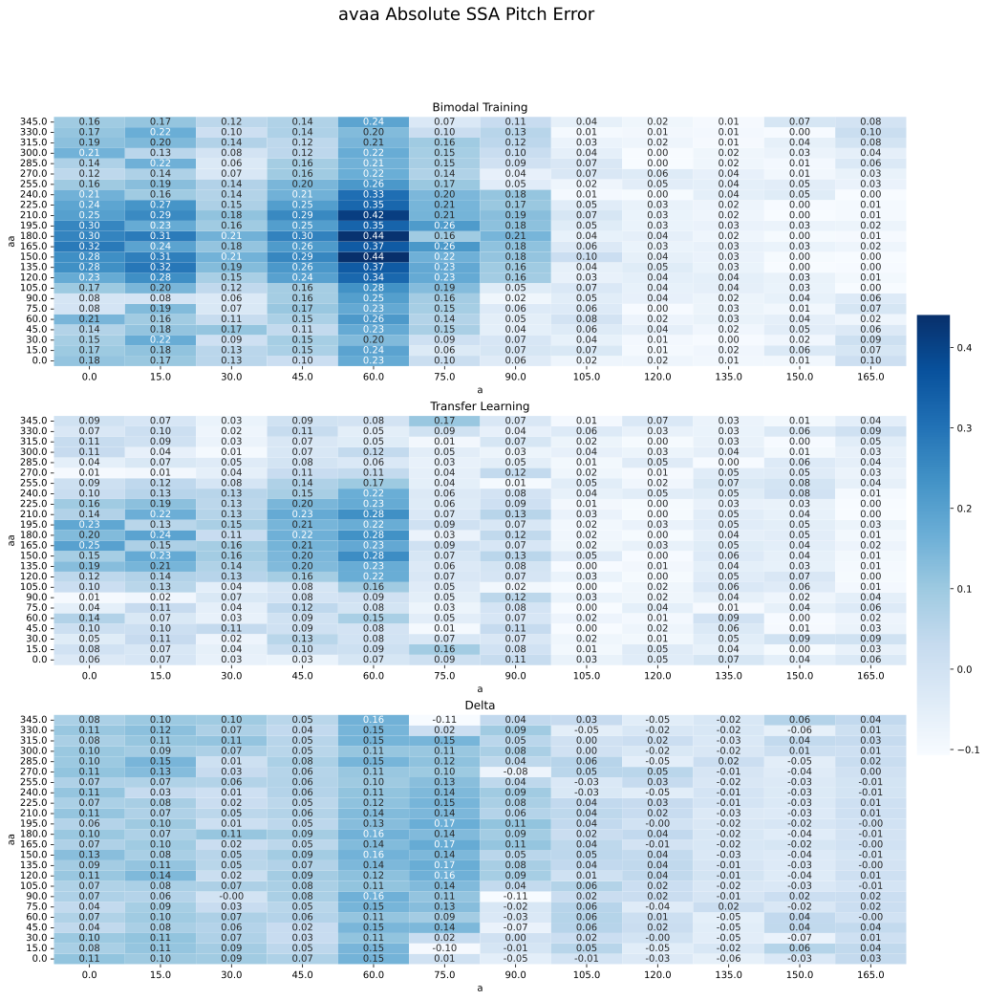

In [6]:
try:
    makeHeatmap('avaa', "Zcg Error", '3')
    makeHeatmap('avaa', "Roll Error", '3')
    makeHeatmap('avaa', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())

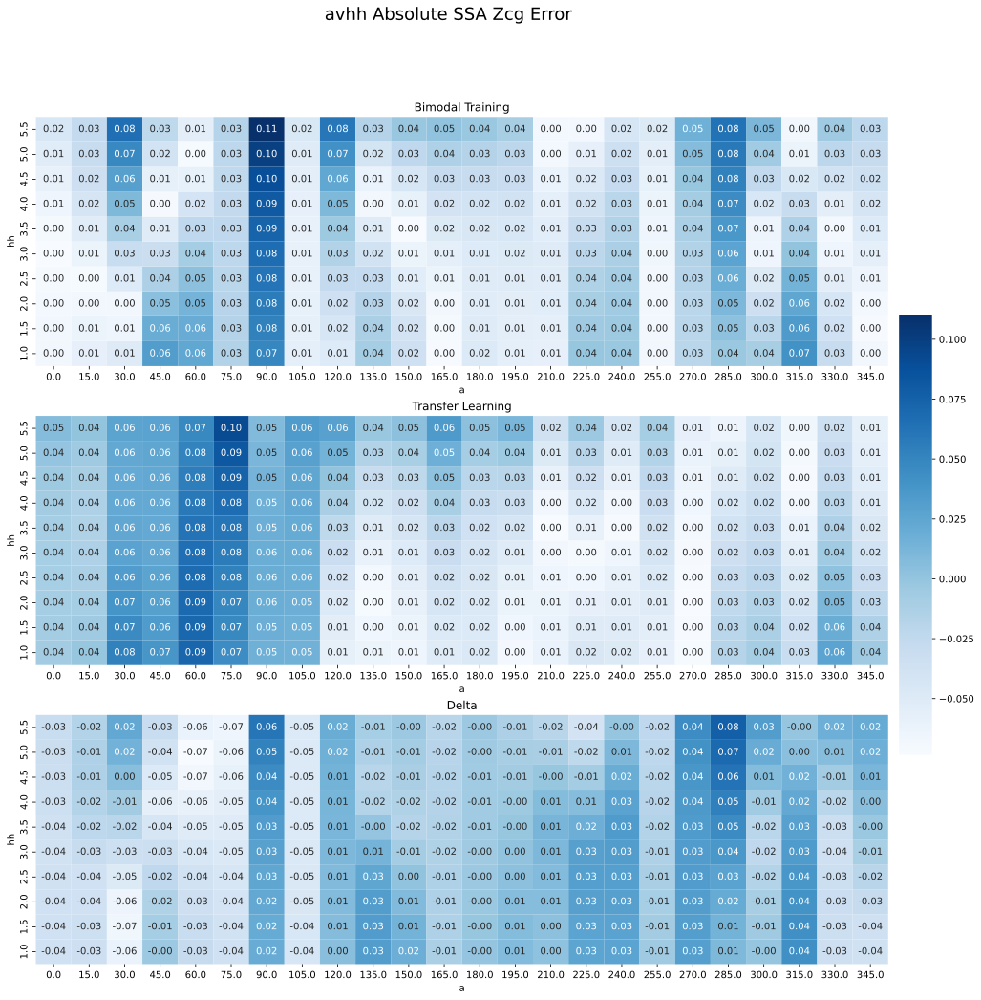

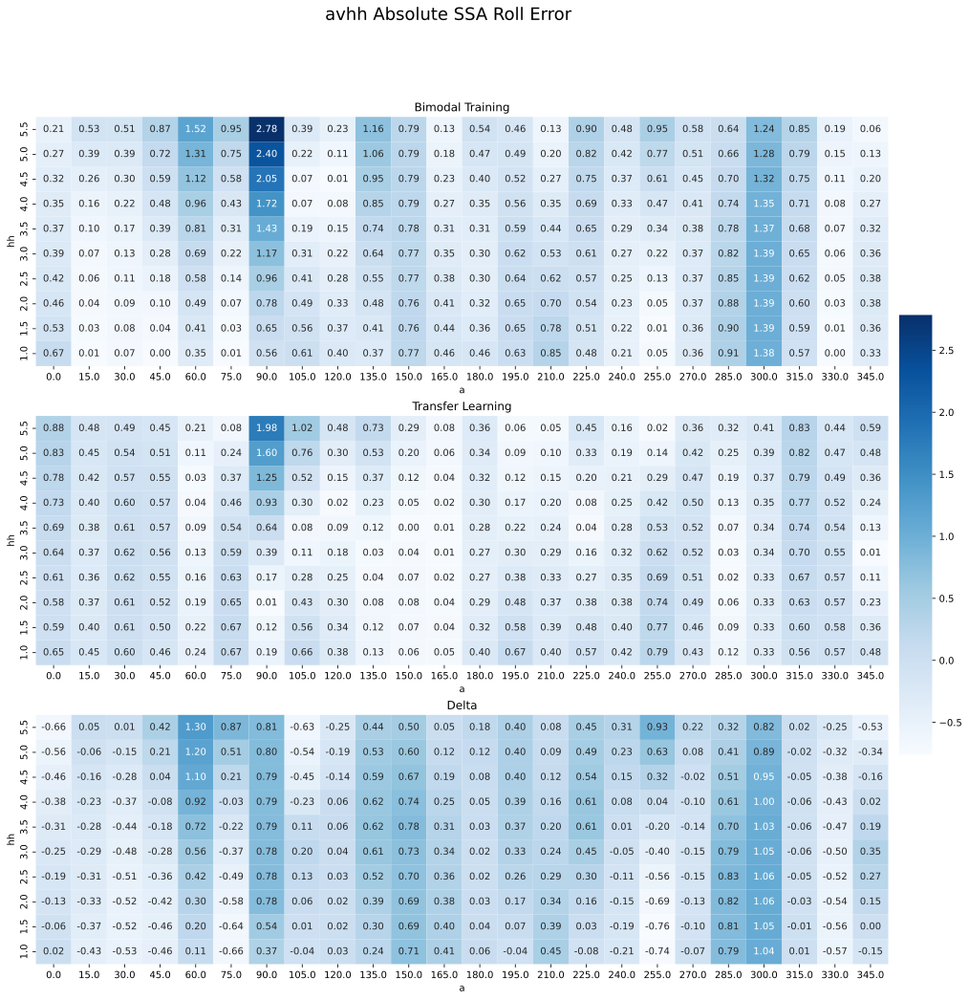

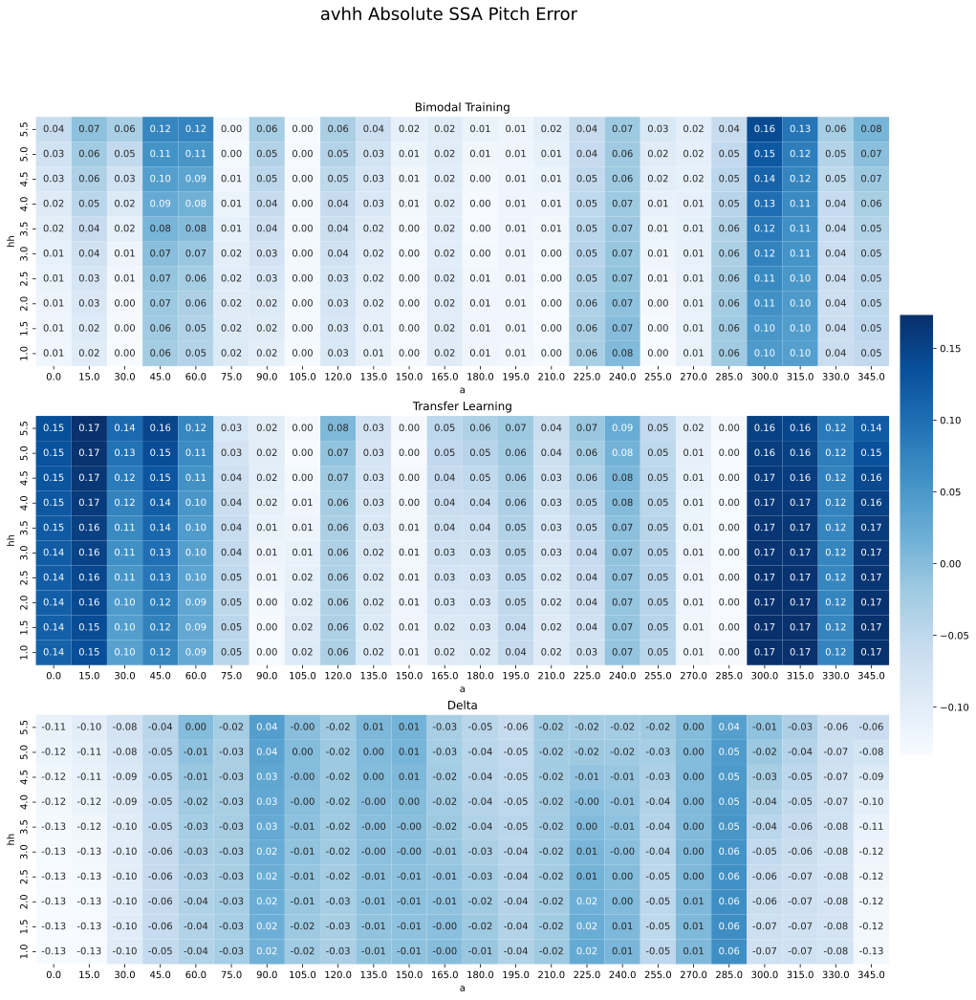

In [7]:
try:
    makeHeatmap('avhh', "Zcg Error", '3')
    makeHeatmap('avhh', "Roll Error", '3')
    makeHeatmap('avhh', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())

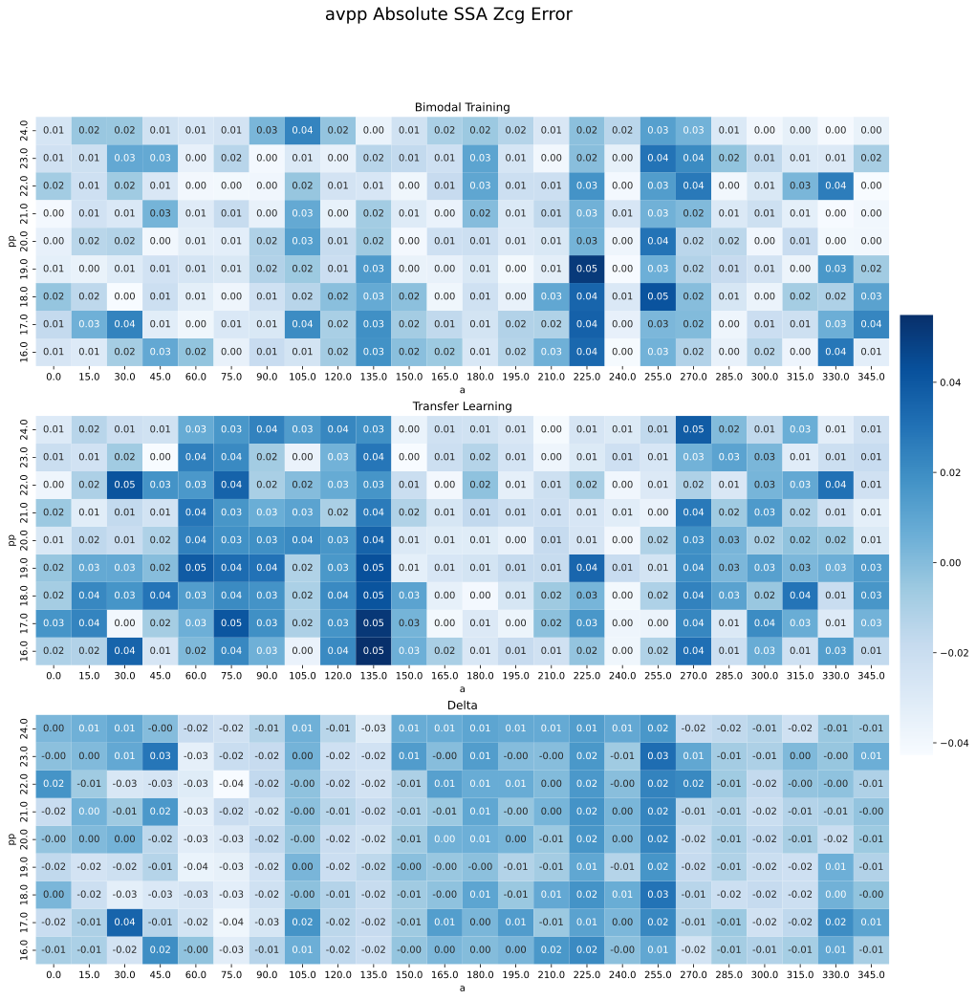

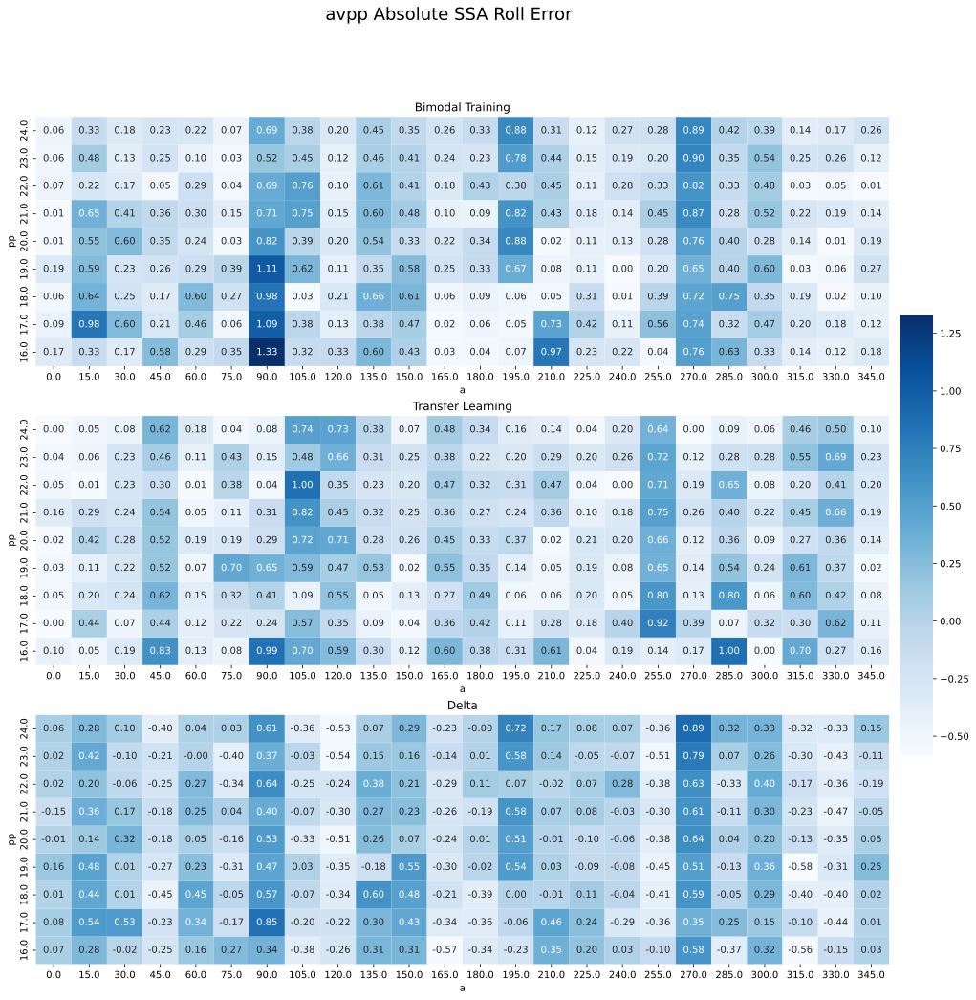

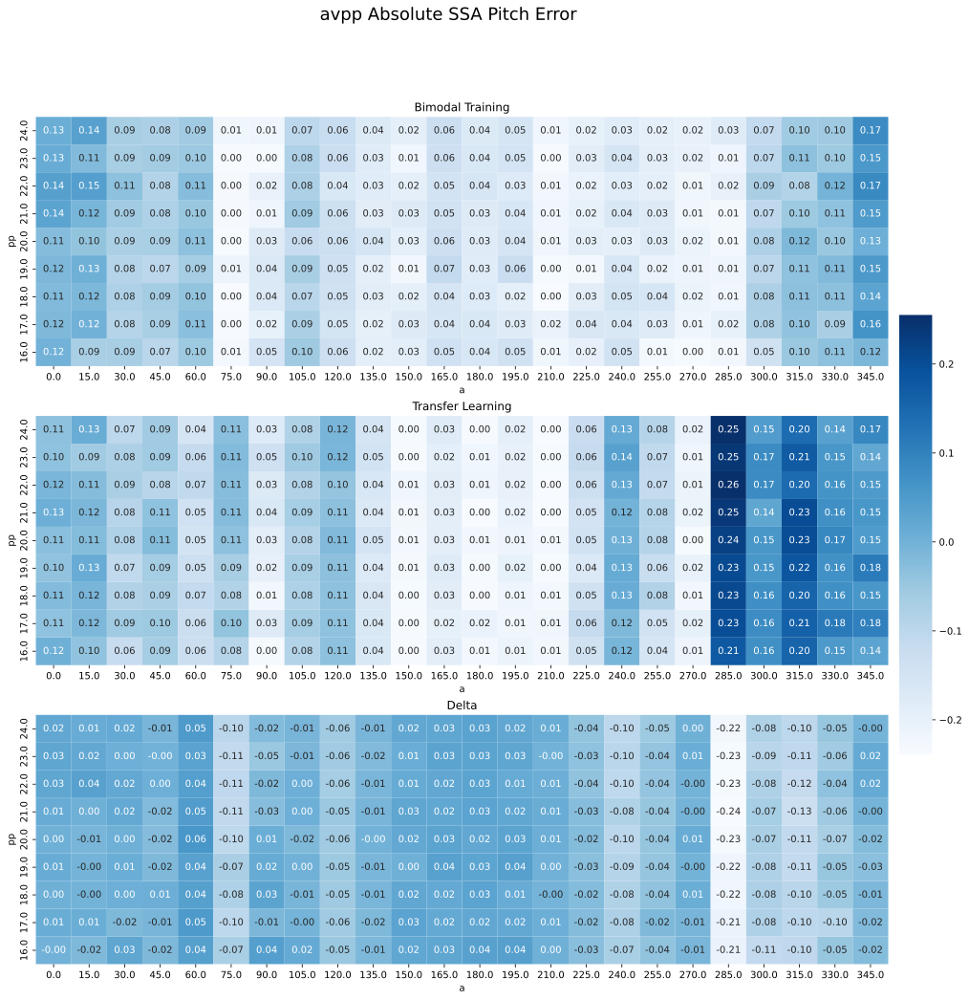

In [8]:
try:
    makeHeatmap('avpp', "Zcg Error", '3')
    makeHeatmap('avpp', "Roll Error", '3')
    makeHeatmap('avpp', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())

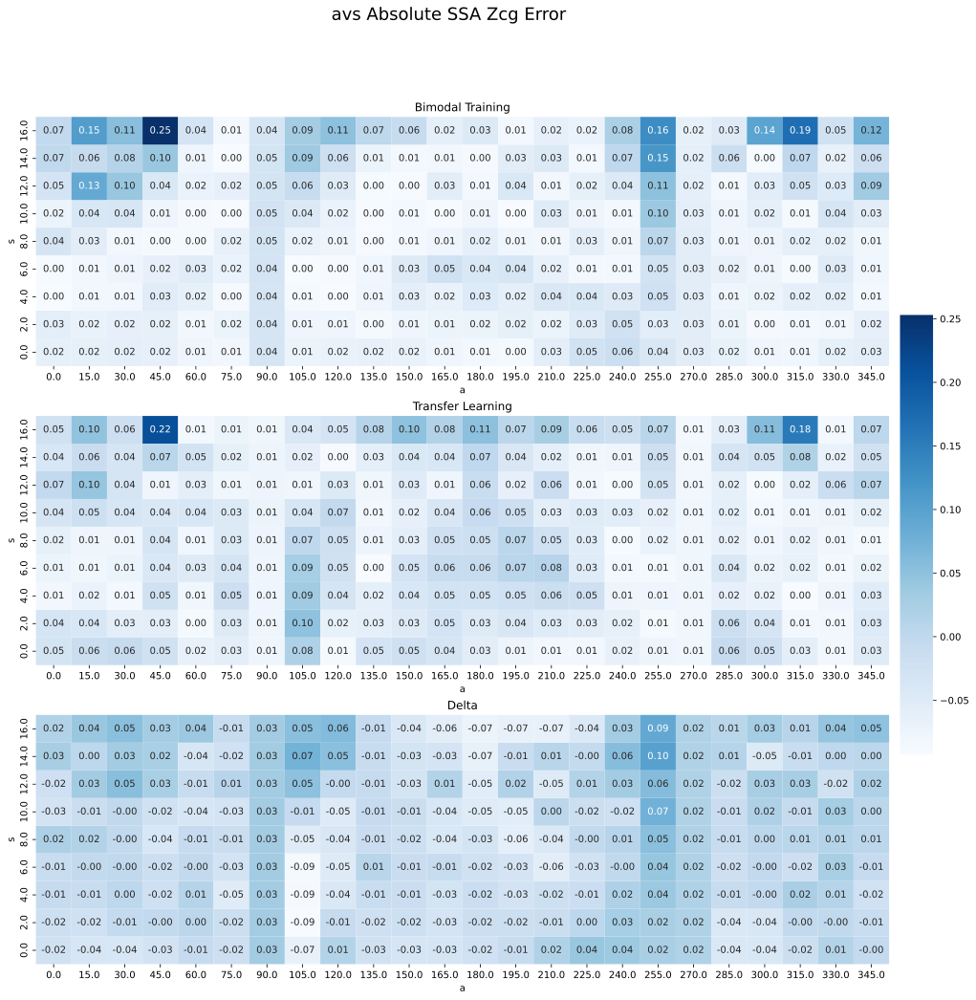

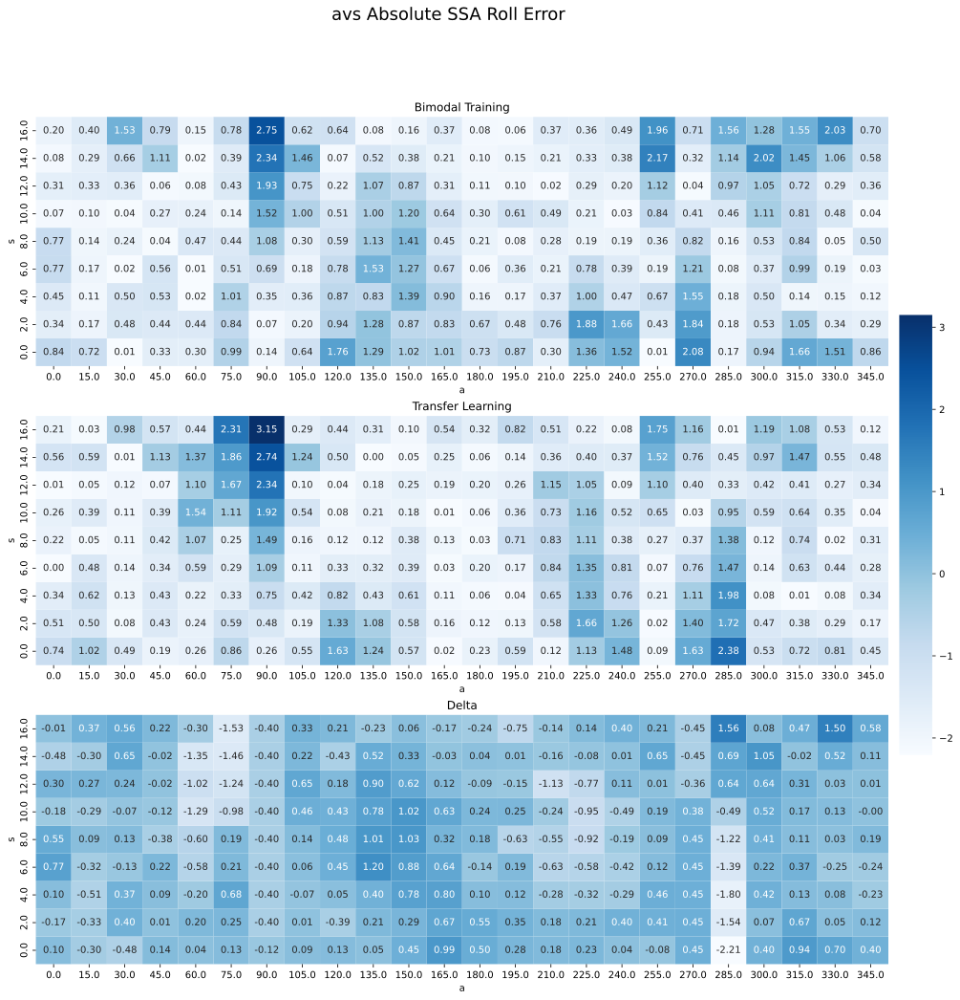

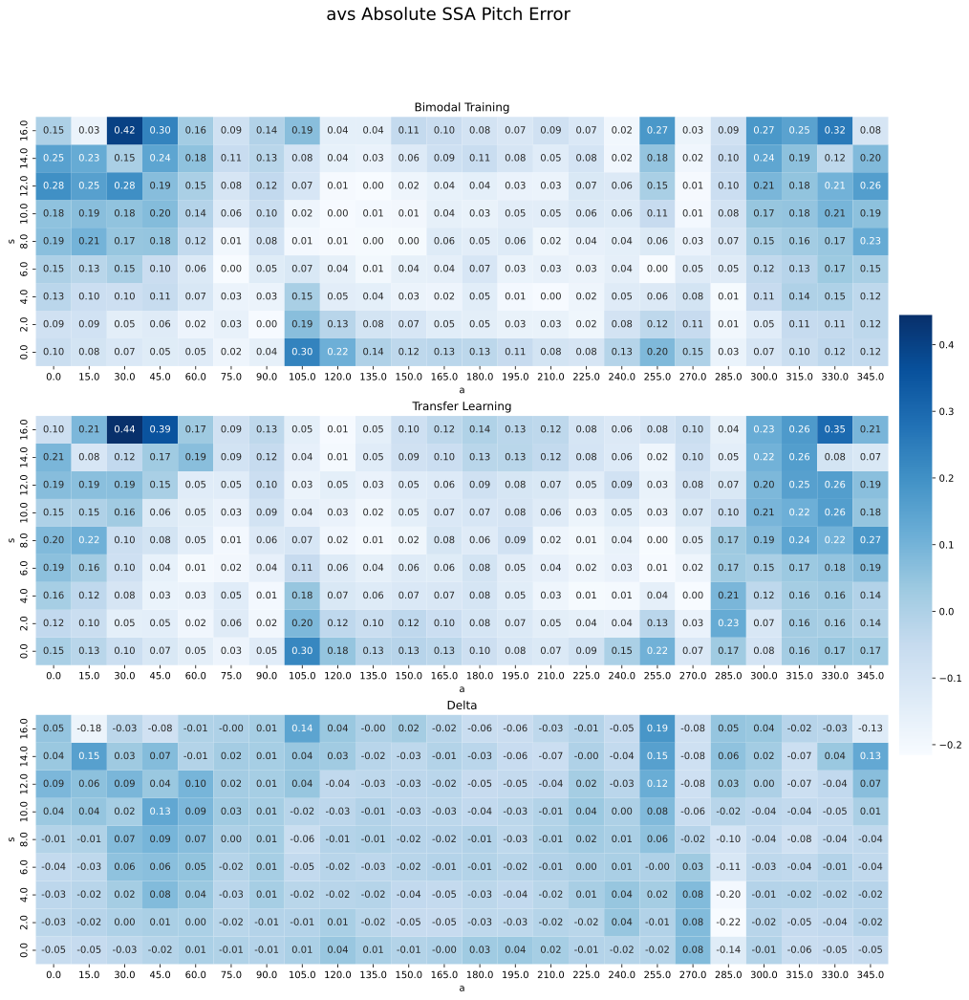

In [9]:
try:
    makeHeatmap('avs', "Zcg Error", '3')
    makeHeatmap('avs', "Roll Error", '3')
    makeHeatmap('avs', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())

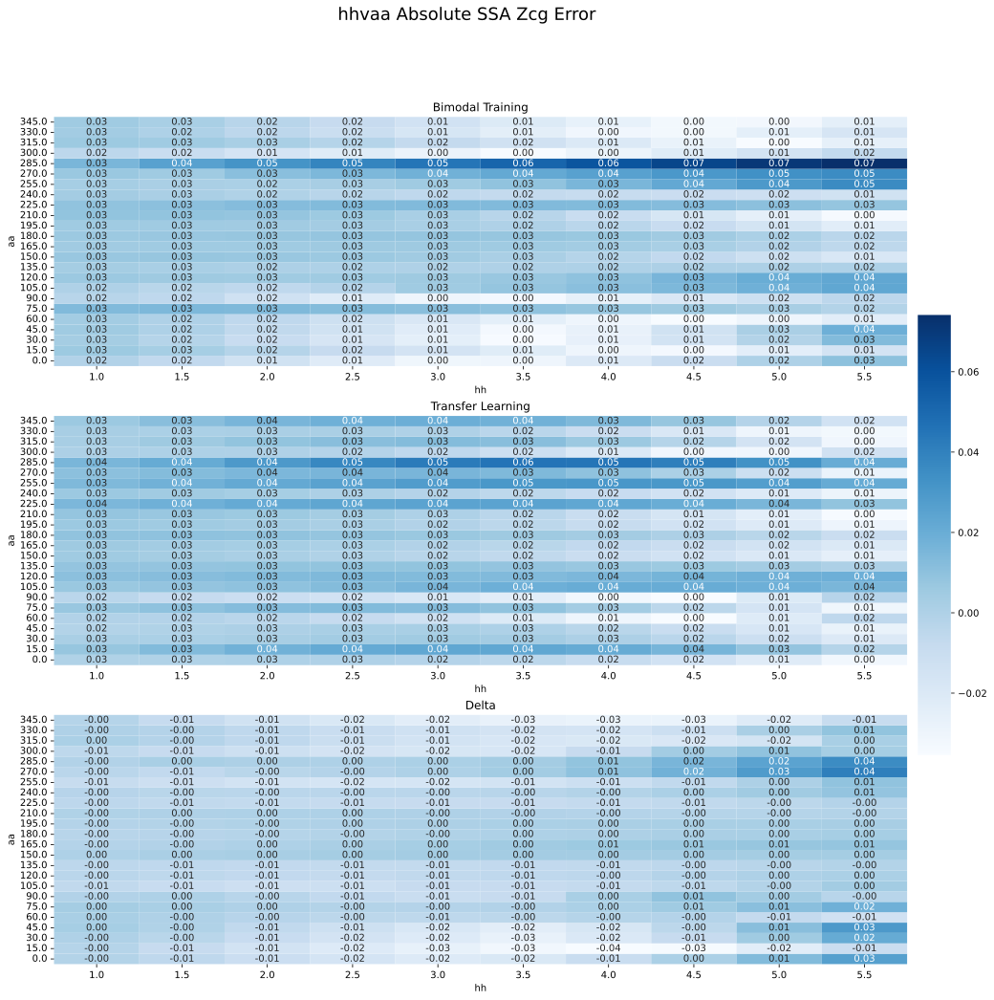

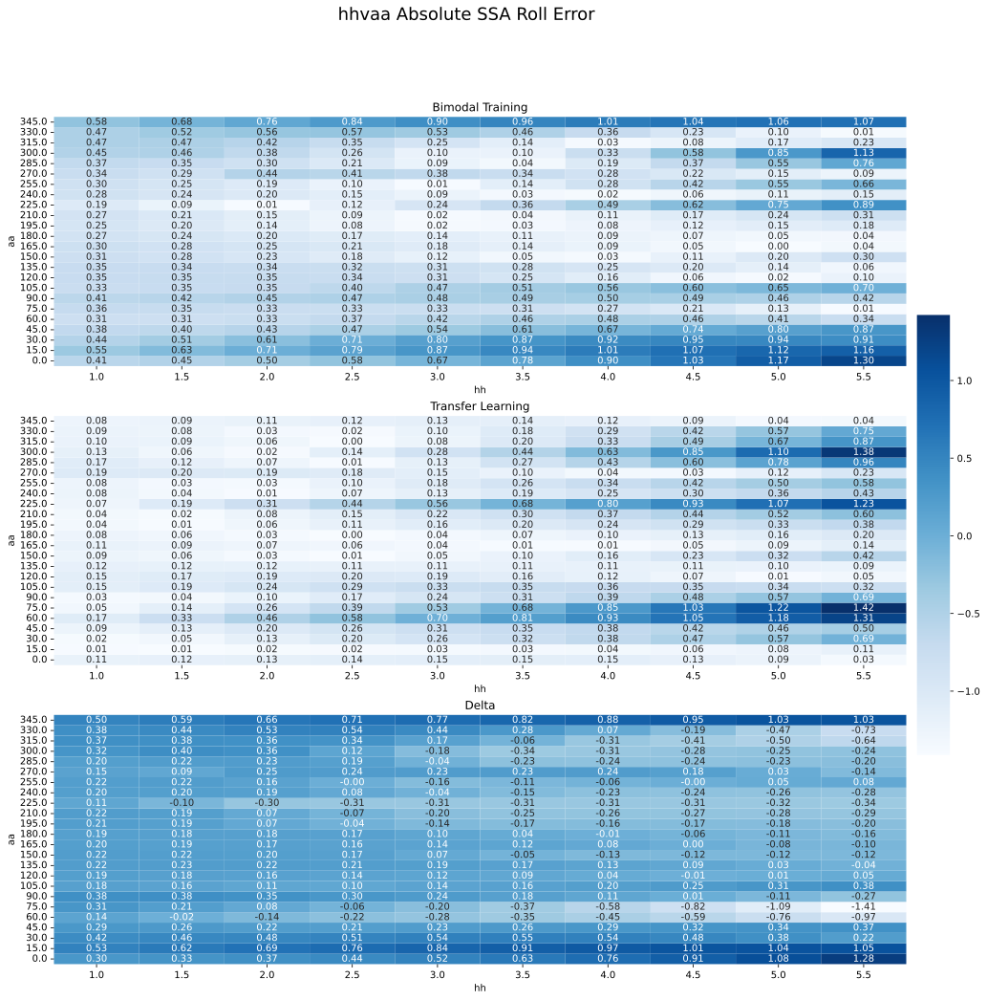

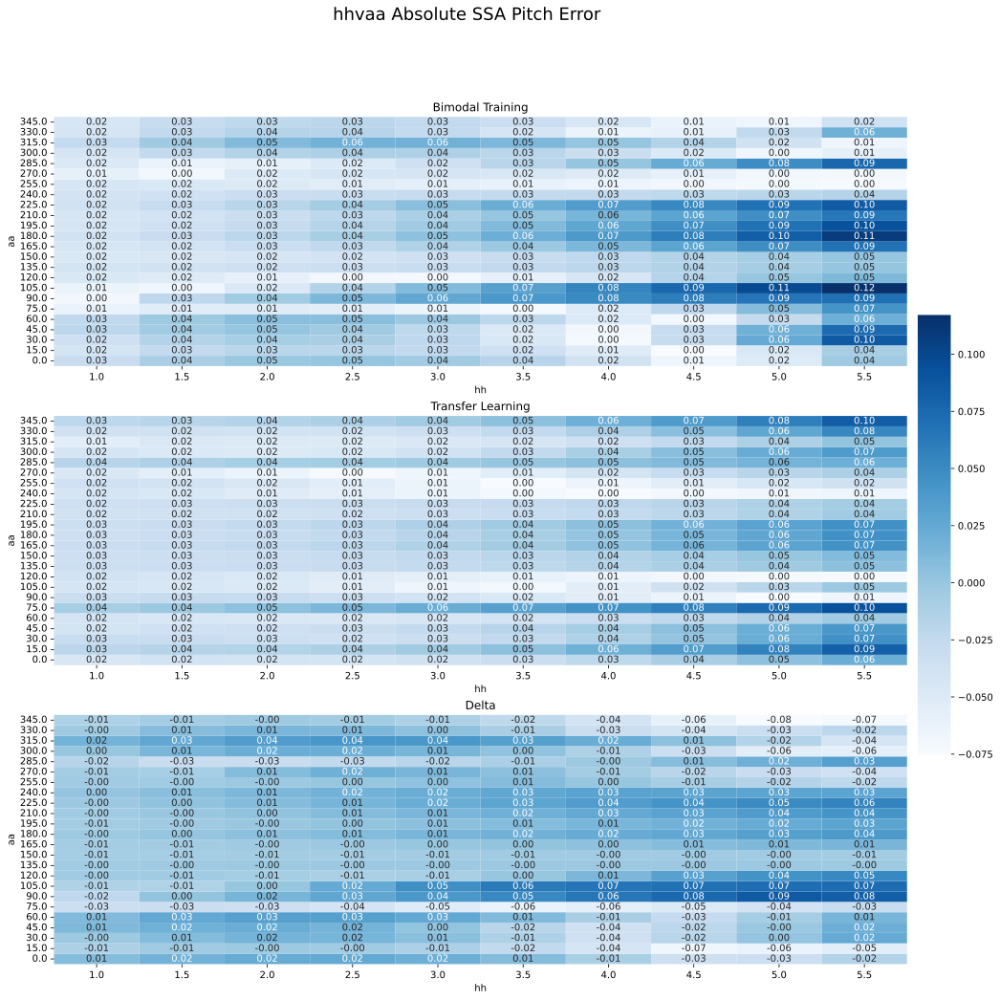

In [10]:
try:
    makeHeatmap('hhvaa', "Zcg Error", '3')
    makeHeatmap('hhvaa', "Roll Error", '3')
    makeHeatmap('hhvaa', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())

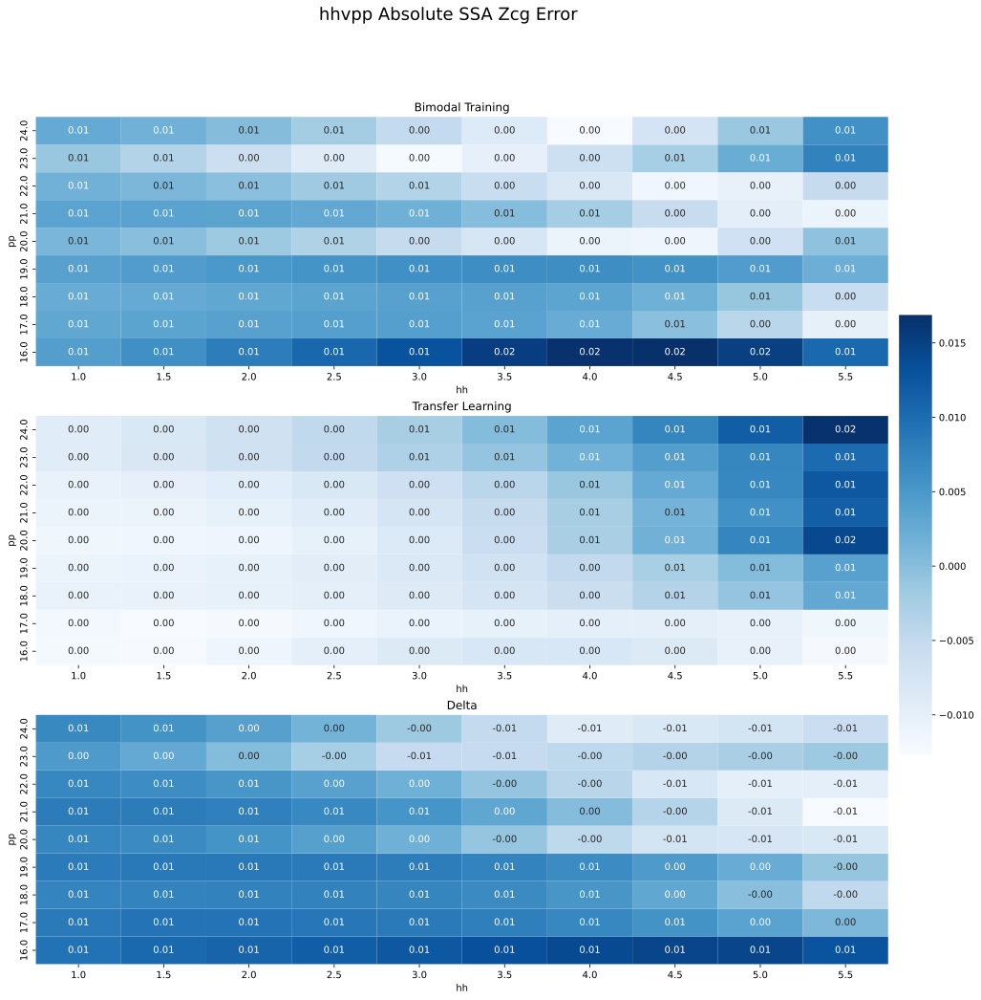

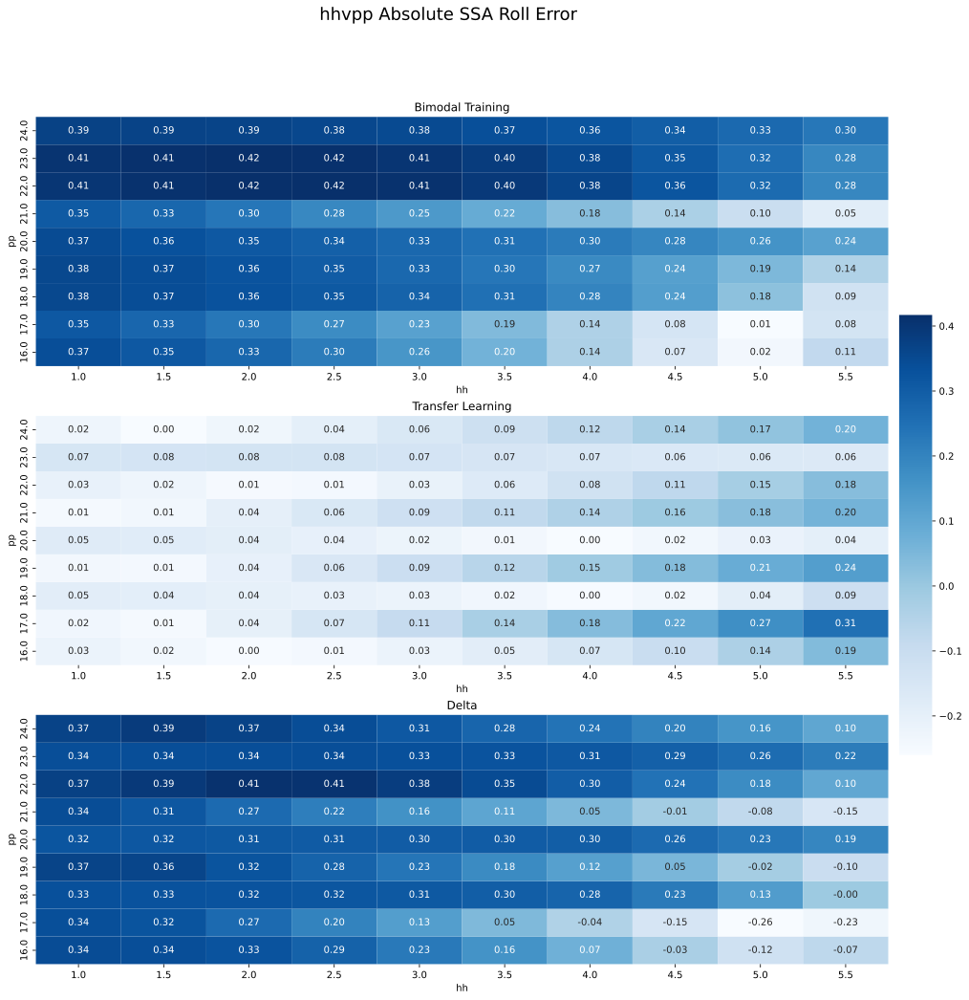

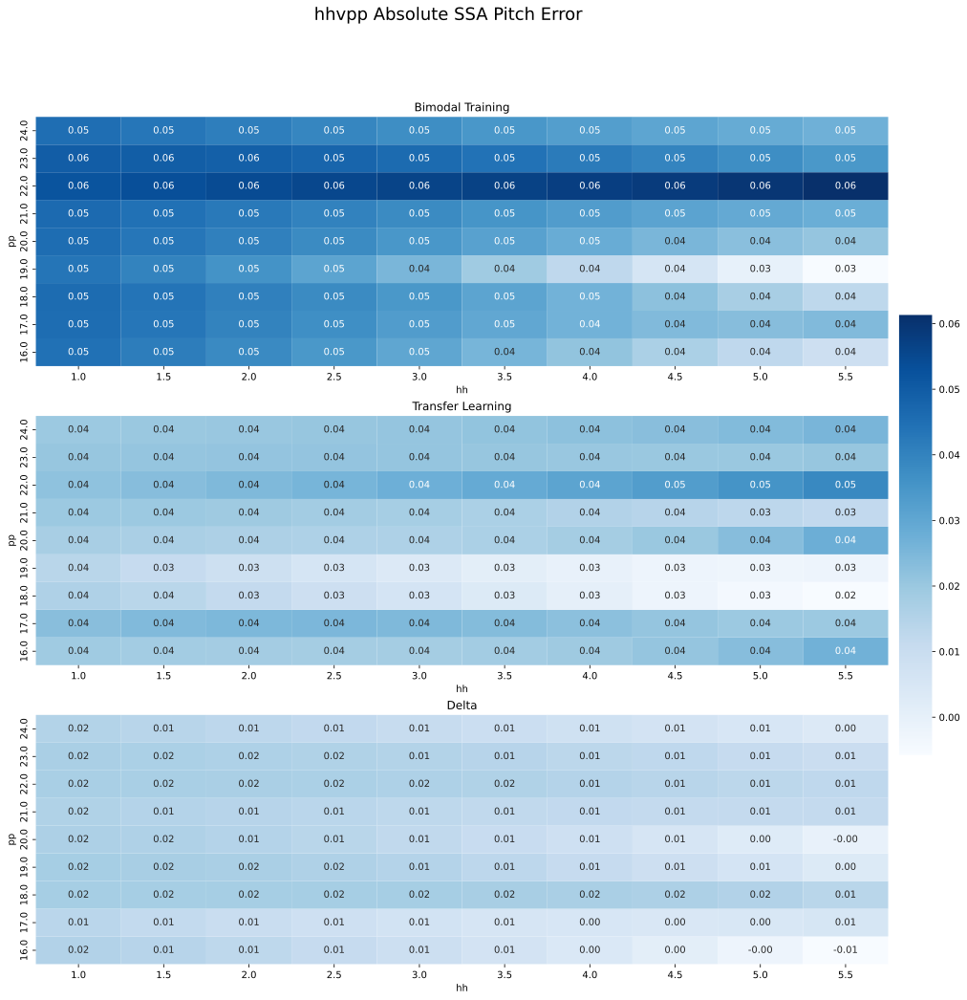

In [11]:
try:
    makeHeatmap('hhvpp', "Zcg Error", '3')
    makeHeatmap('hhvpp', "Roll Error", '3')
    makeHeatmap('hhvpp', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())

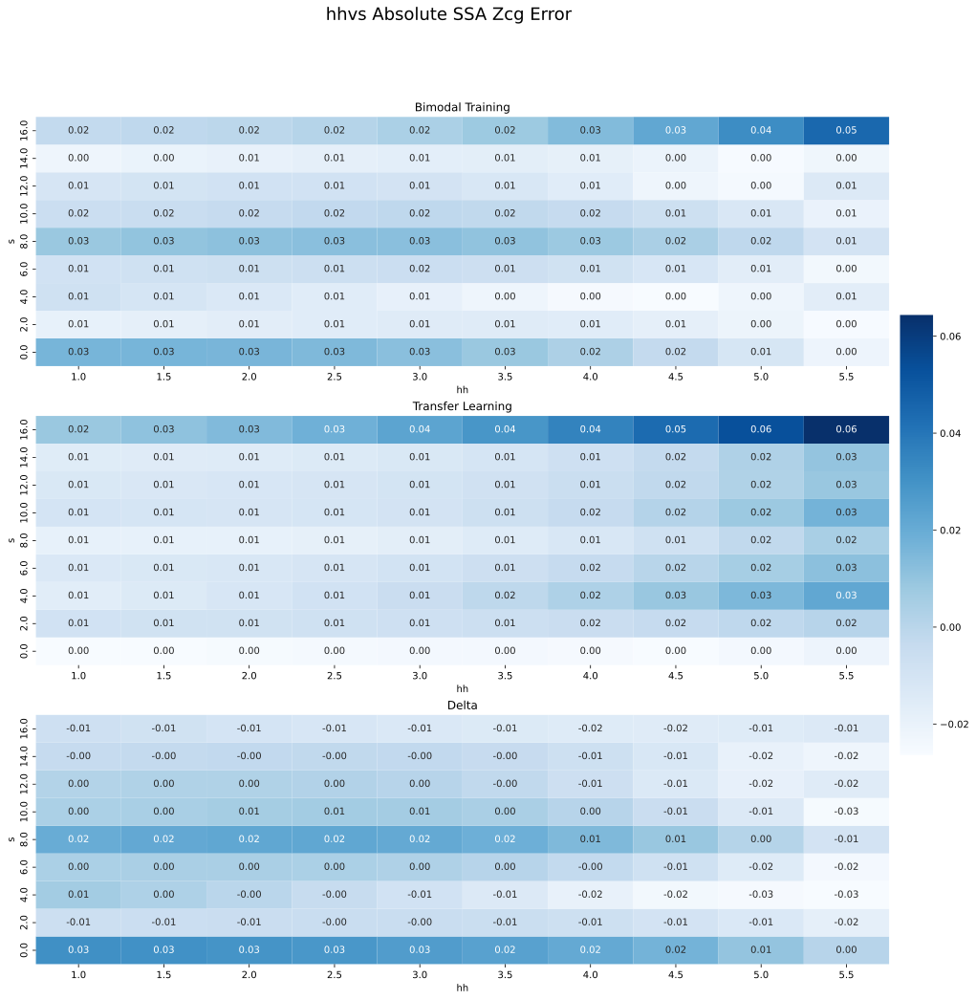

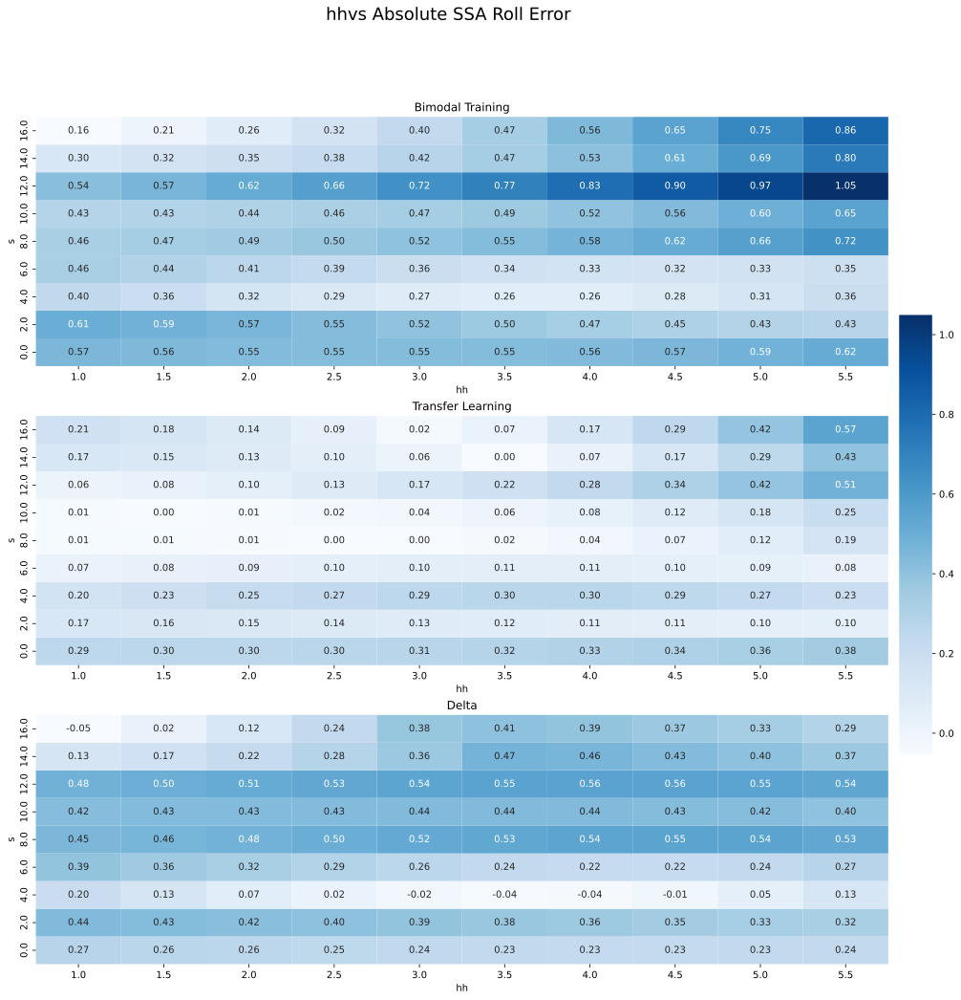

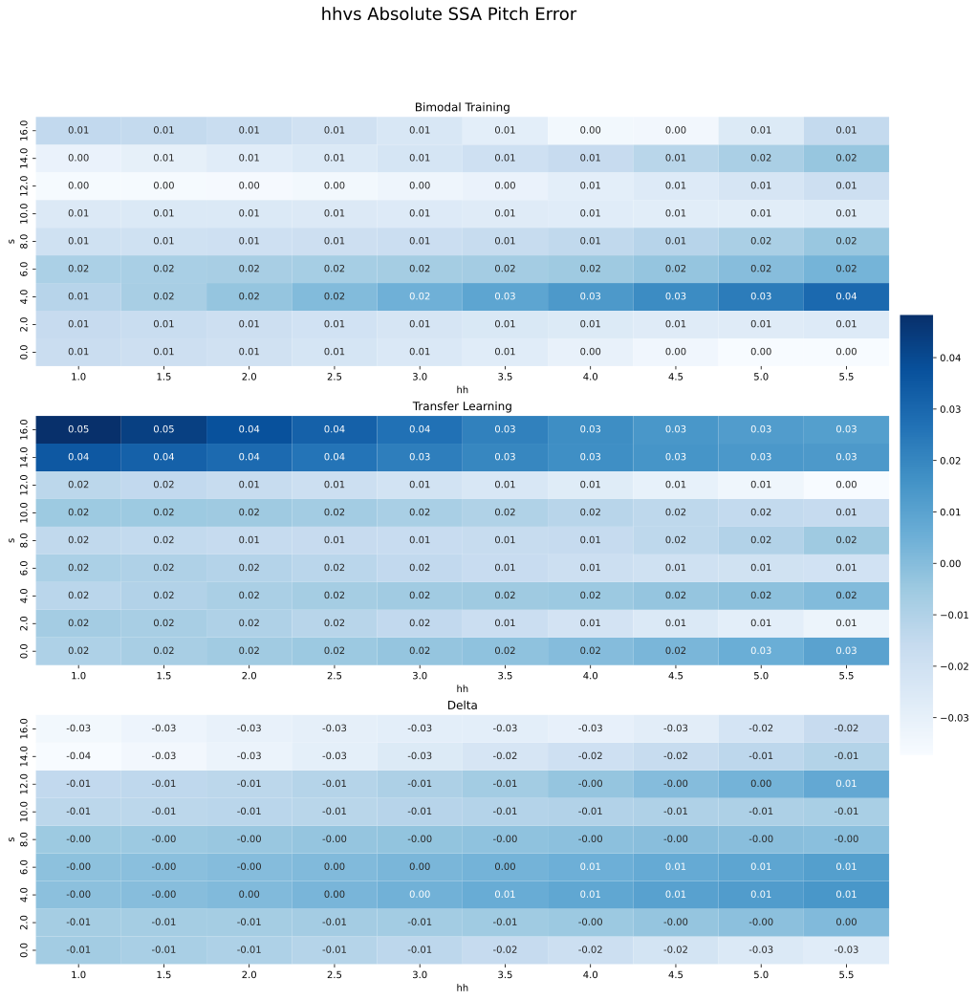

In [12]:
try:
    makeHeatmap('hhvs', "Zcg Error", '3')
    makeHeatmap('hhvs', "Roll Error", '3')
    makeHeatmap('hhvs', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())

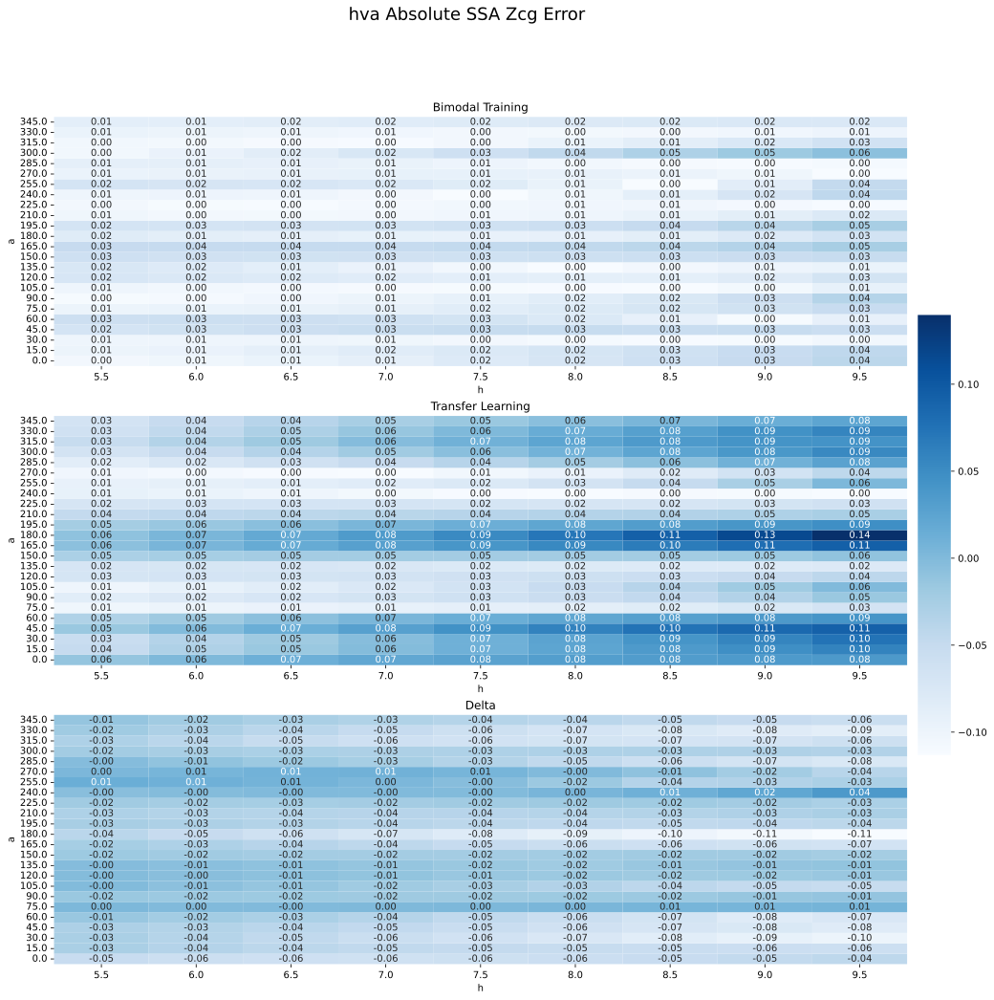

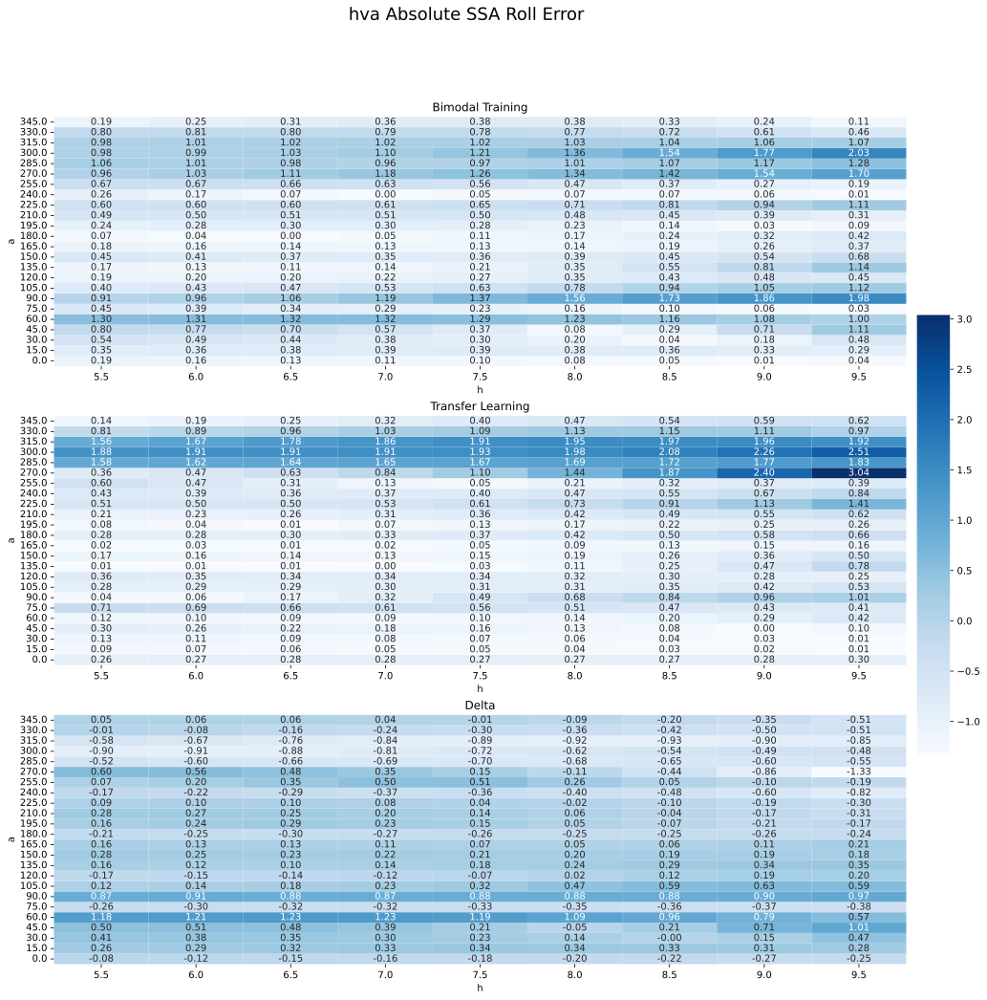

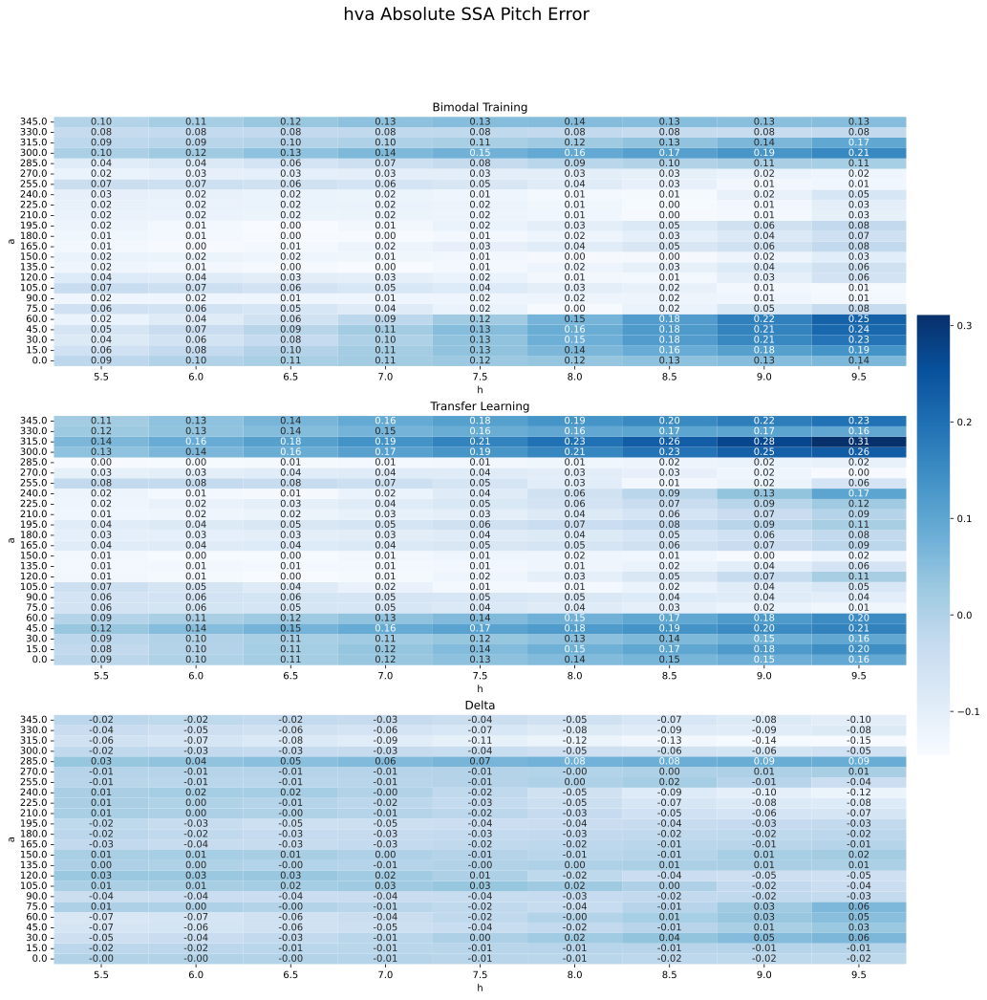

In [13]:
try:
    makeHeatmap('hva', "Zcg Error", '3')
    makeHeatmap('hva', "Roll Error", '3')
    makeHeatmap('hva', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())

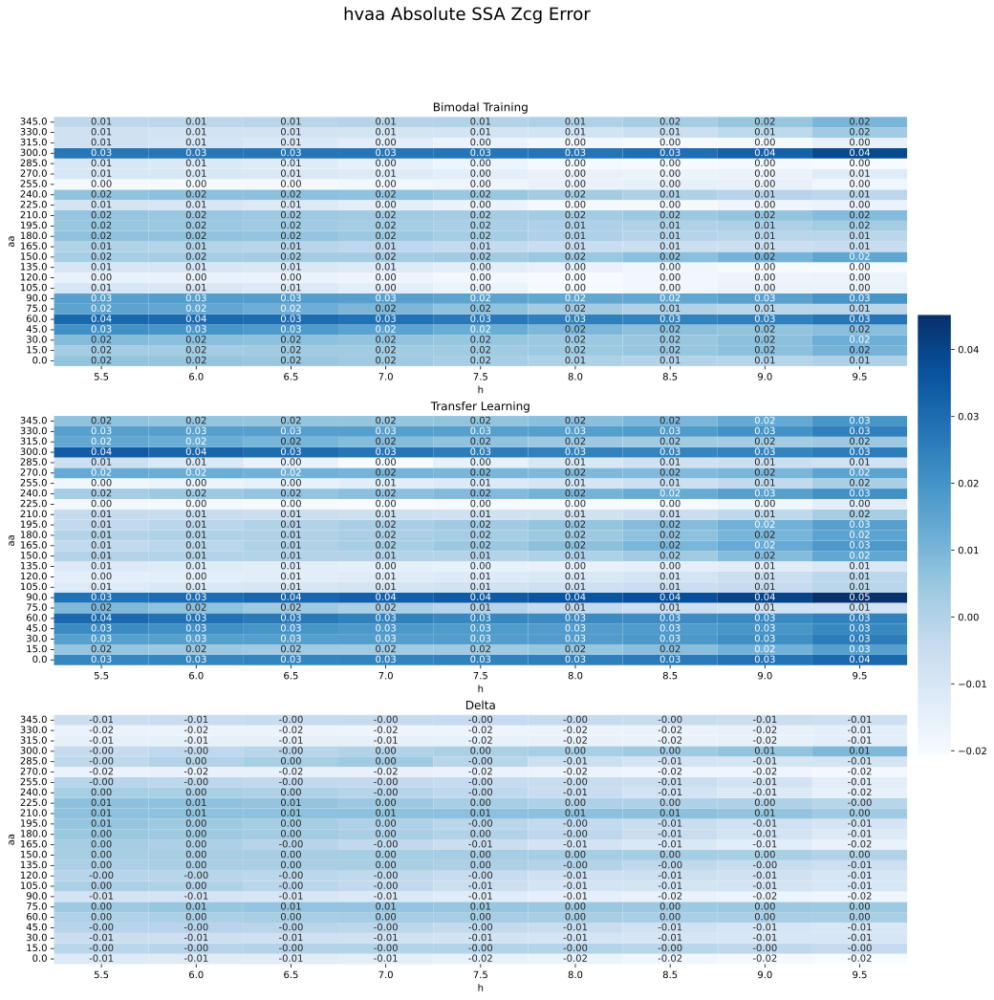

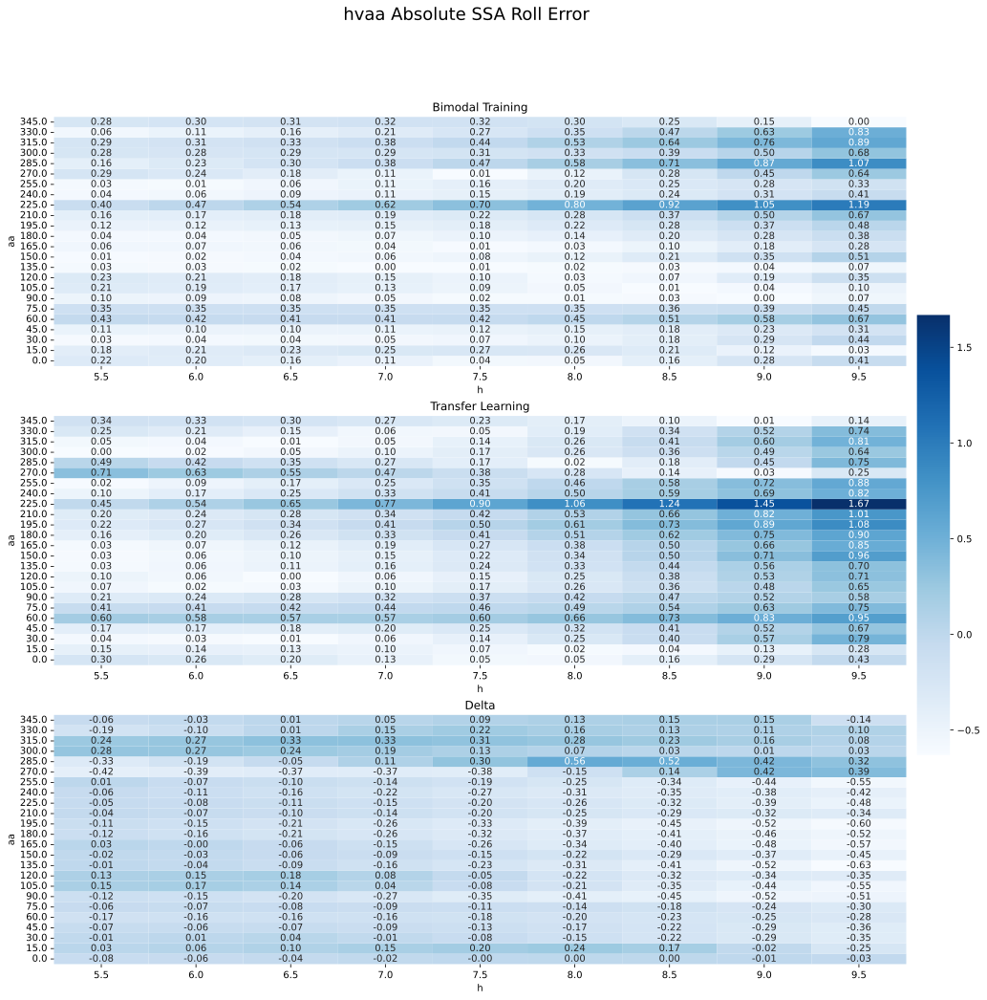

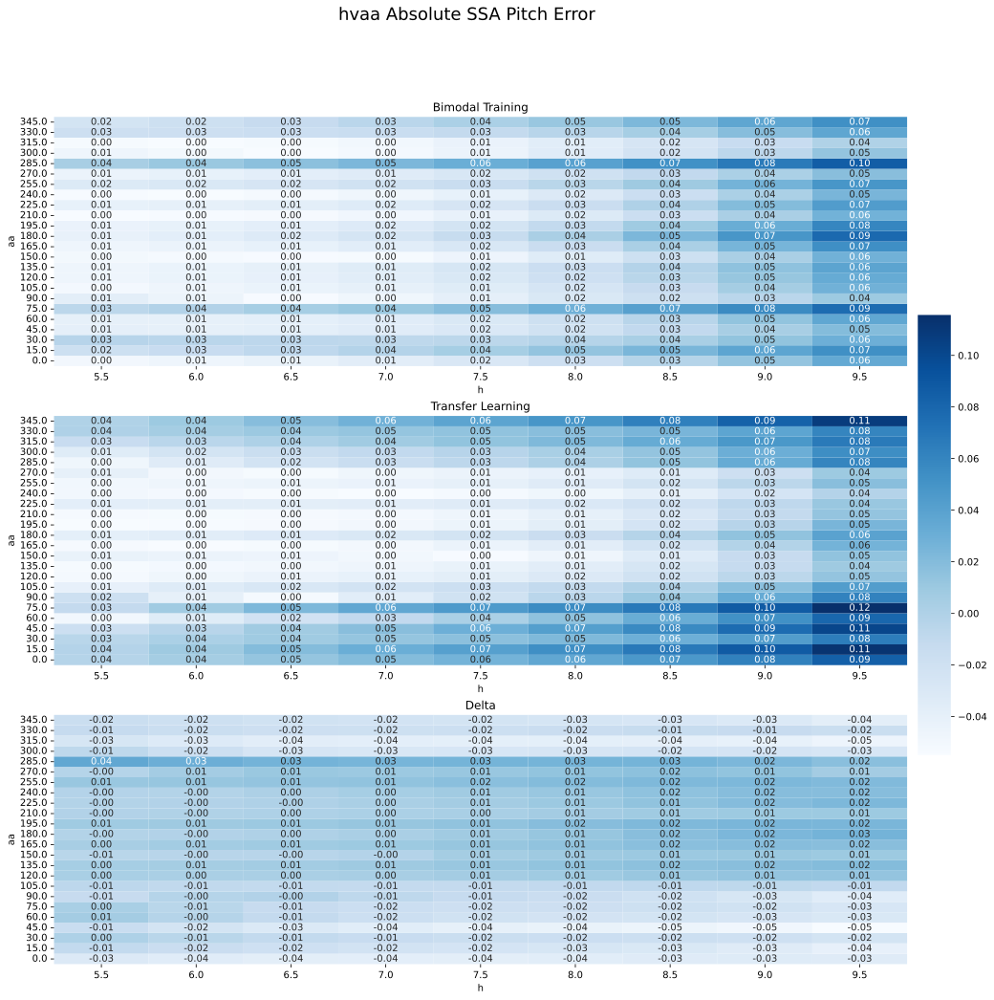

In [14]:
try:
    makeHeatmap('hvaa', "Zcg Error", '3')
    makeHeatmap('hvaa', "Roll Error", '3')
    makeHeatmap('hvaa', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())

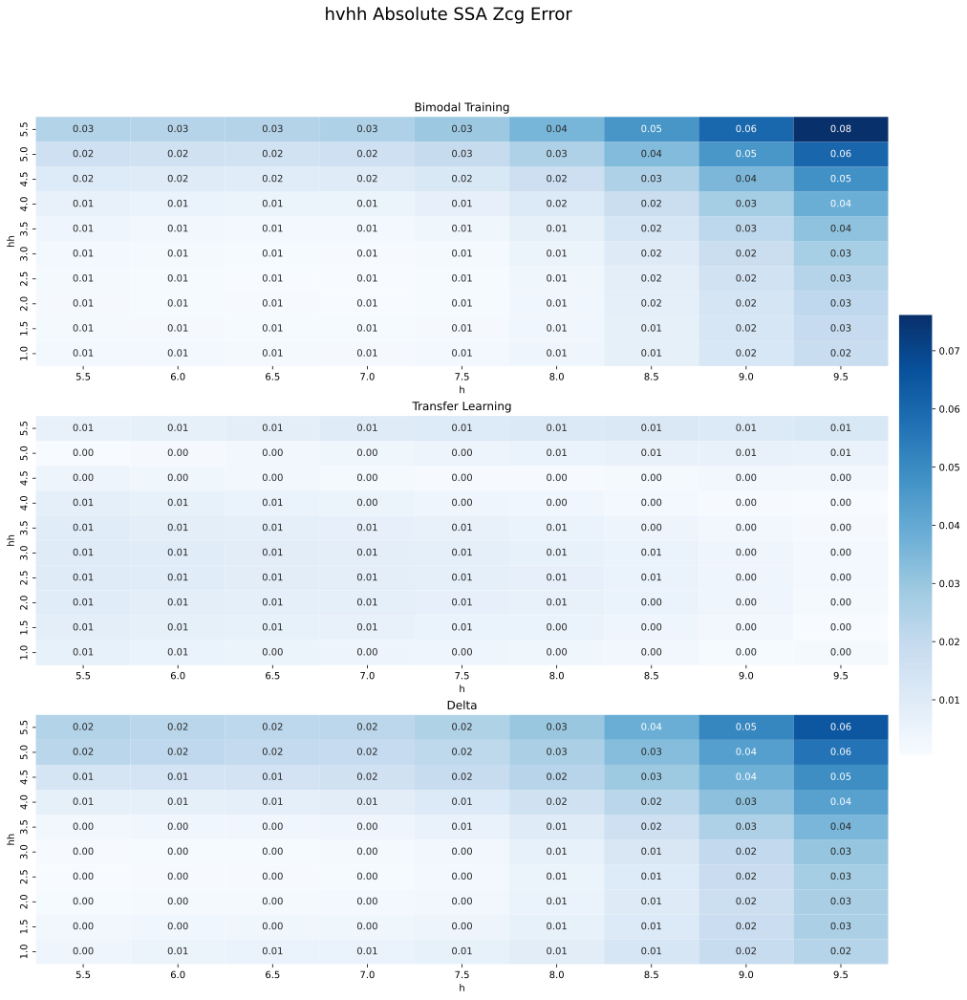

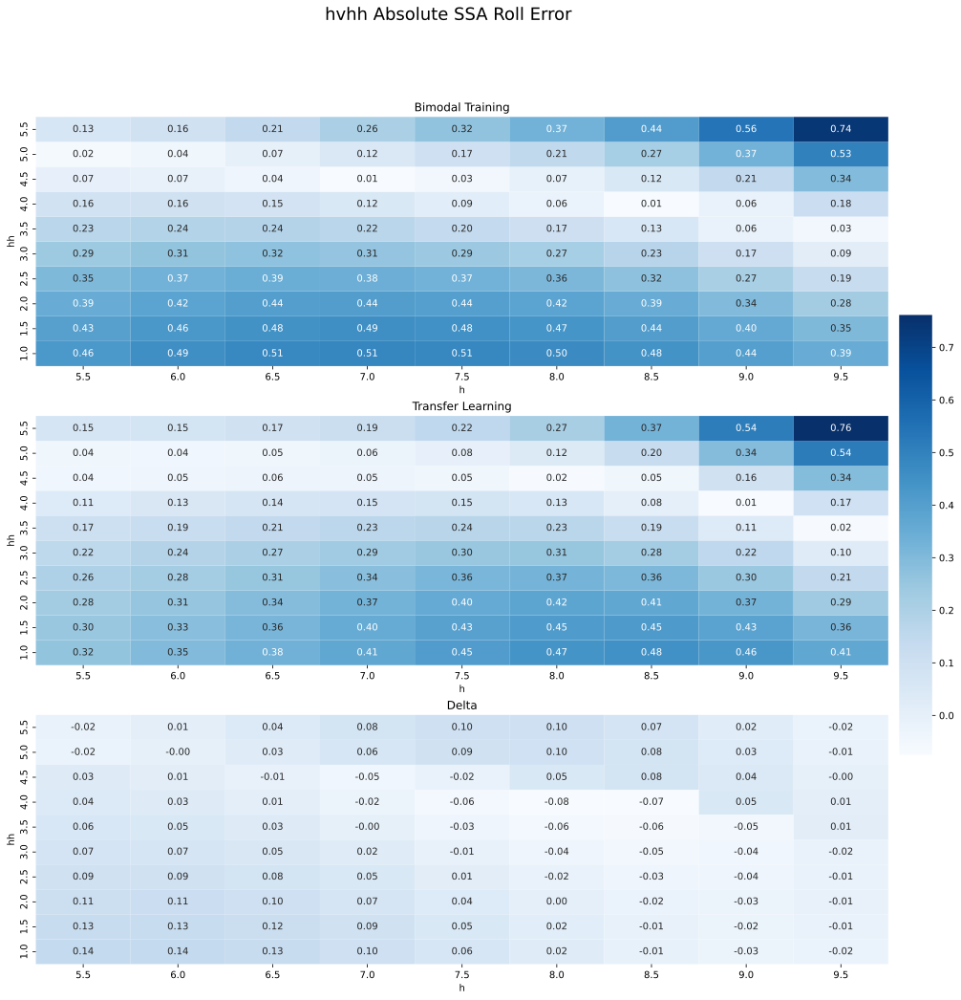

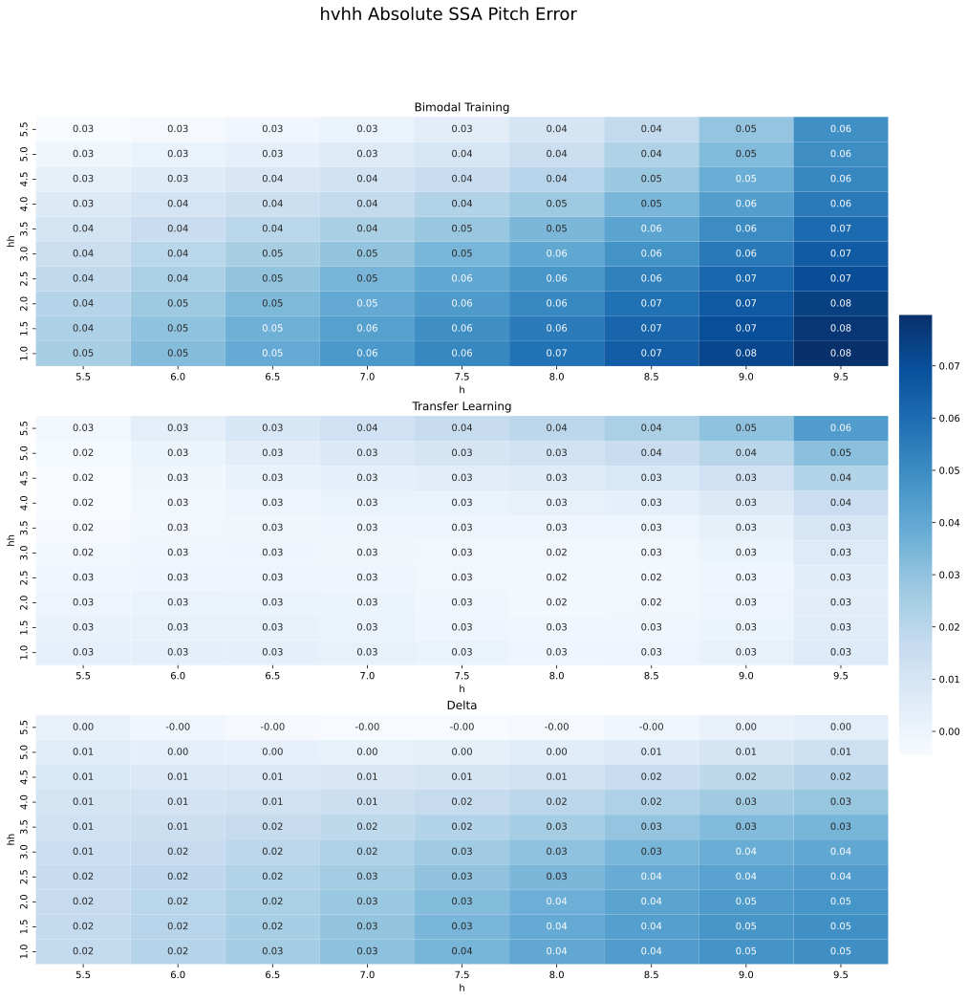

In [15]:
try:
    makeHeatmap('hvhh', "Zcg Error", '3')
    makeHeatmap('hvhh', "Roll Error", '3')
    makeHeatmap('hvhh', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())

ERROR:root:Traceback (most recent call last):
  File "C:\Users\jarod\AppData\Local\Temp\ipykernel_27948\736668394.py", line 2, in <module>
    makeHeatmap('hvp', "Zcg Error", '3')
  File "C:\Users\jarod\AppData\Local\Temp\ipykernel_27948\333675488.py", line 27, in makeHeatmap
    resulto = dfo.pivot(index=v2, columns=v1, values=parameter)
  File "h:\OneDrive - Massachusetts Institute of Technology\Thesis\SimpleCode_to_LAMP_LSTM\venv\lib\site-packages\pandas\core\frame.py", line 7885, in pivot
    return pivot(self, index=index, columns=columns, values=values)
  File "h:\OneDrive - Massachusetts Institute of Technology\Thesis\SimpleCode_to_LAMP_LSTM\venv\lib\site-packages\pandas\core\reshape\pivot.py", line 520, in pivot
    return indexed.unstack(columns_listlike)
  File "h:\OneDrive - Massachusetts Institute of Technology\Thesis\SimpleCode_to_LAMP_LSTM\venv\lib\site-packages\pandas\core\series.py", line 4157, in unstack
    return unstack(self, level, fill_value)
  File "h:\OneDrive -

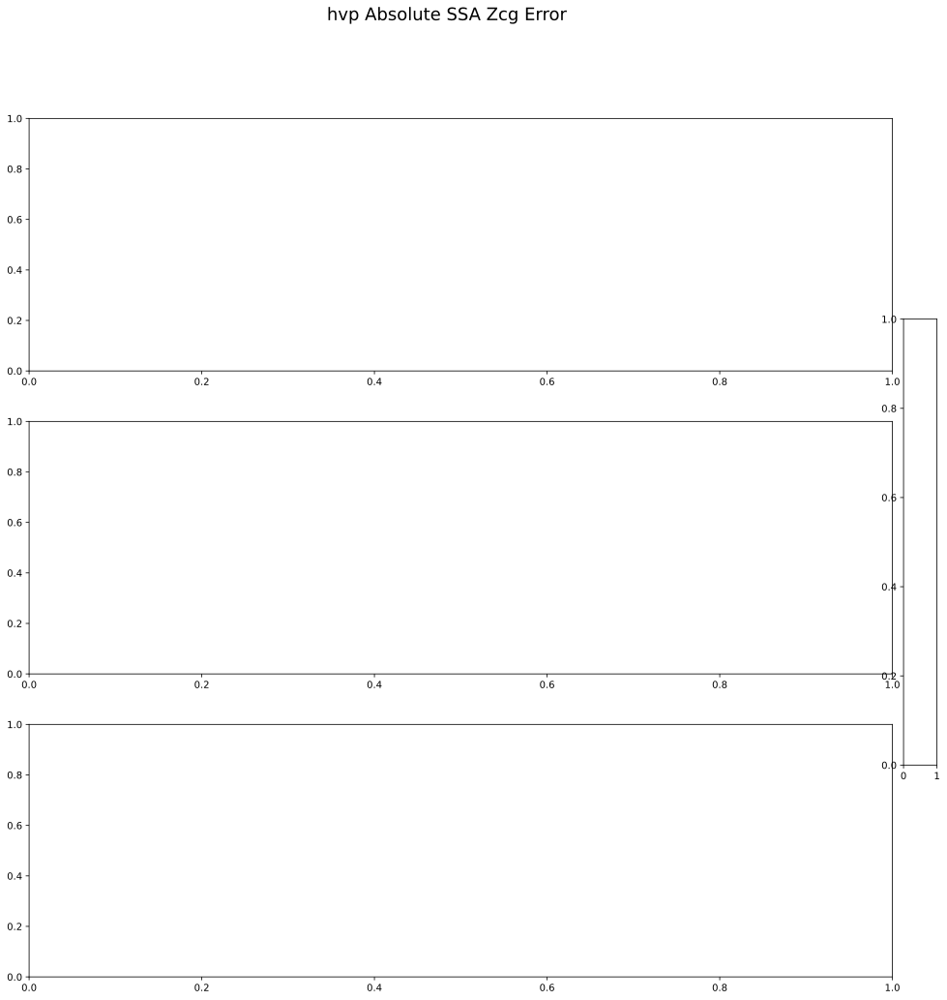

In [16]:
try:
    makeHeatmap('hvp', "Zcg Error", '3')
    makeHeatmap('hvp', "Roll Error", '3')
    makeHeatmap('hvp', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())

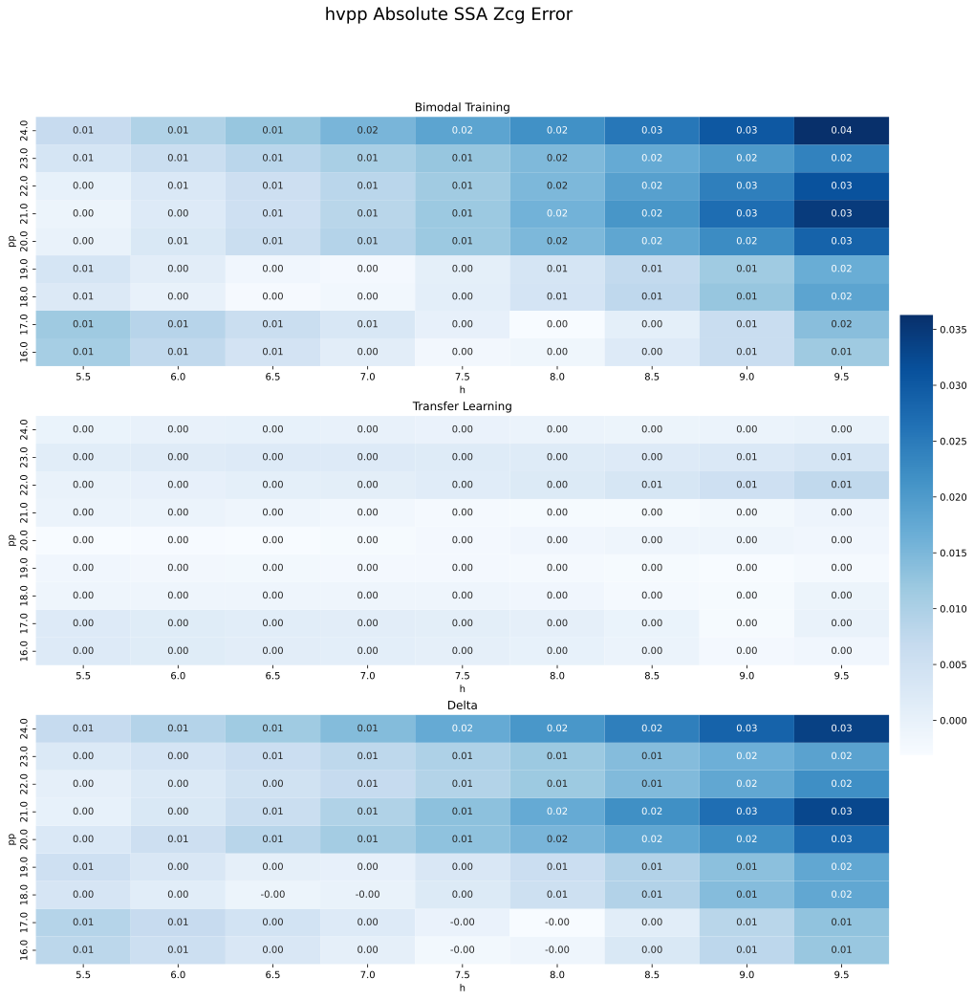

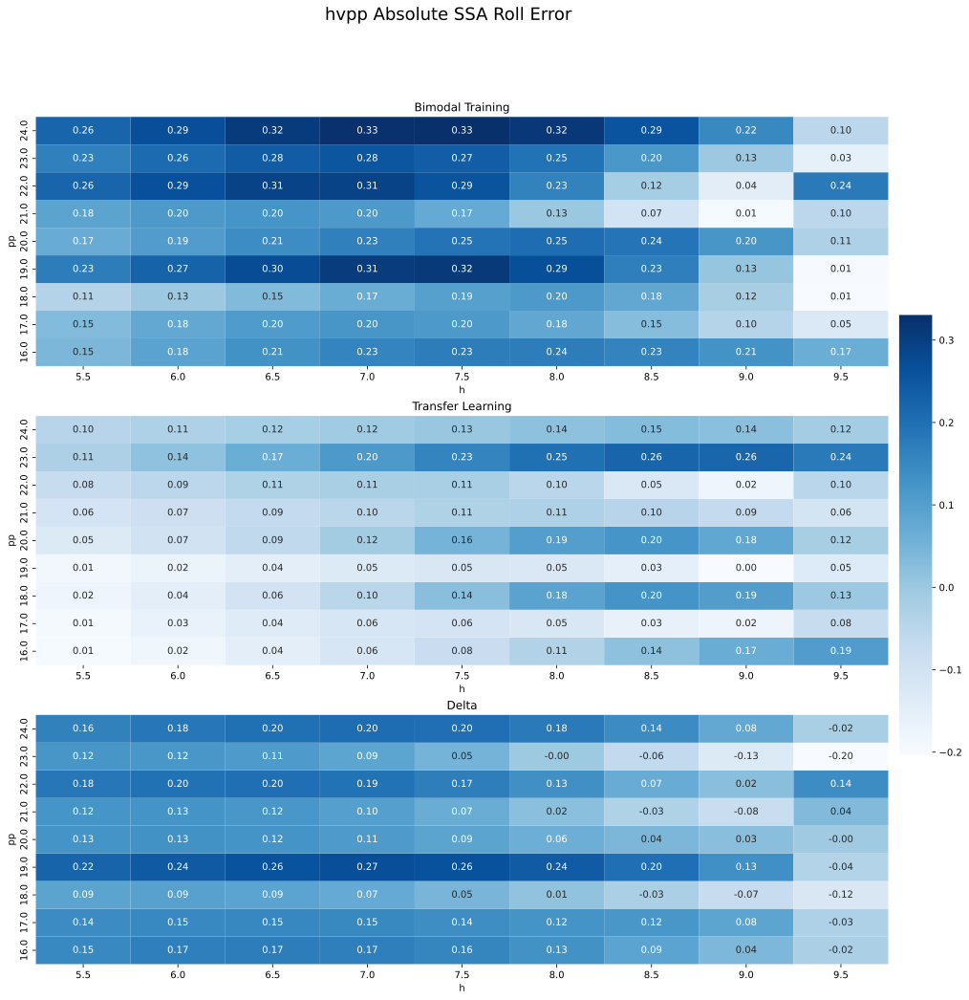

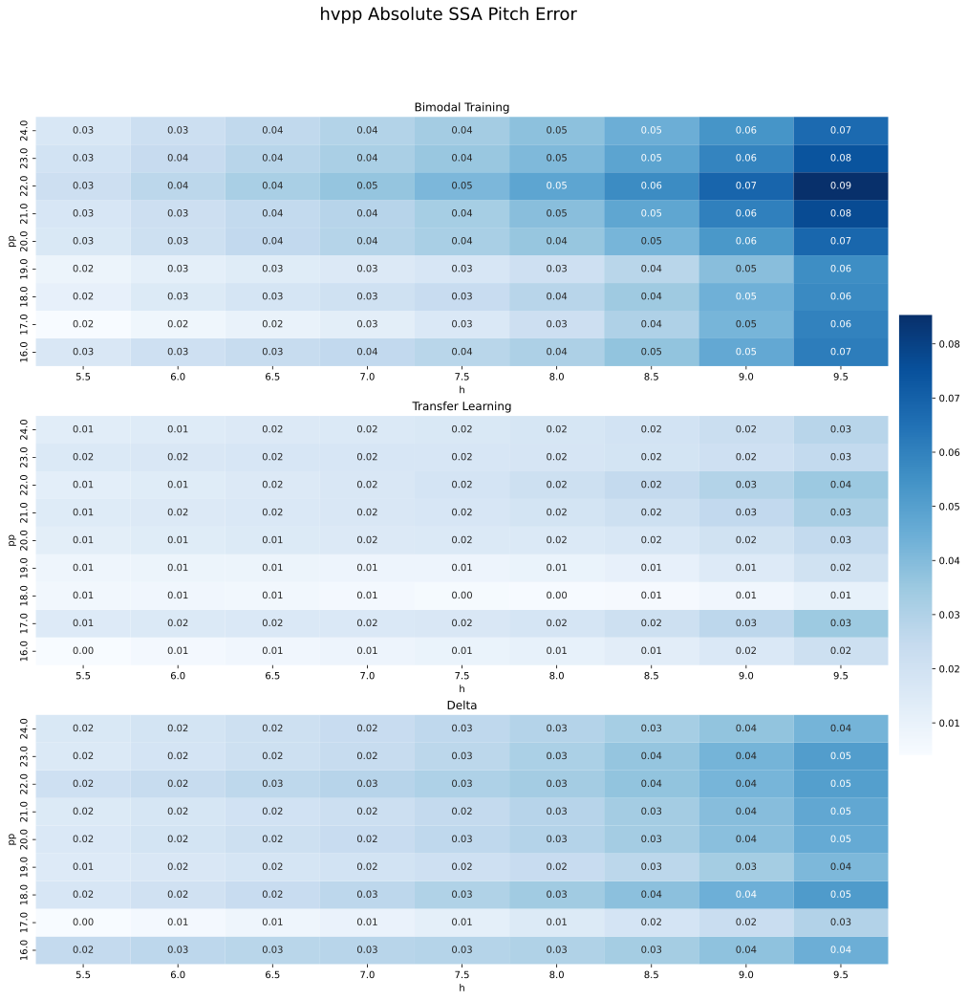

In [17]:
try:
    makeHeatmap('hvpp', "Zcg Error", '3')
    makeHeatmap('hvpp', "Roll Error", '3')
    makeHeatmap('hvpp', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())

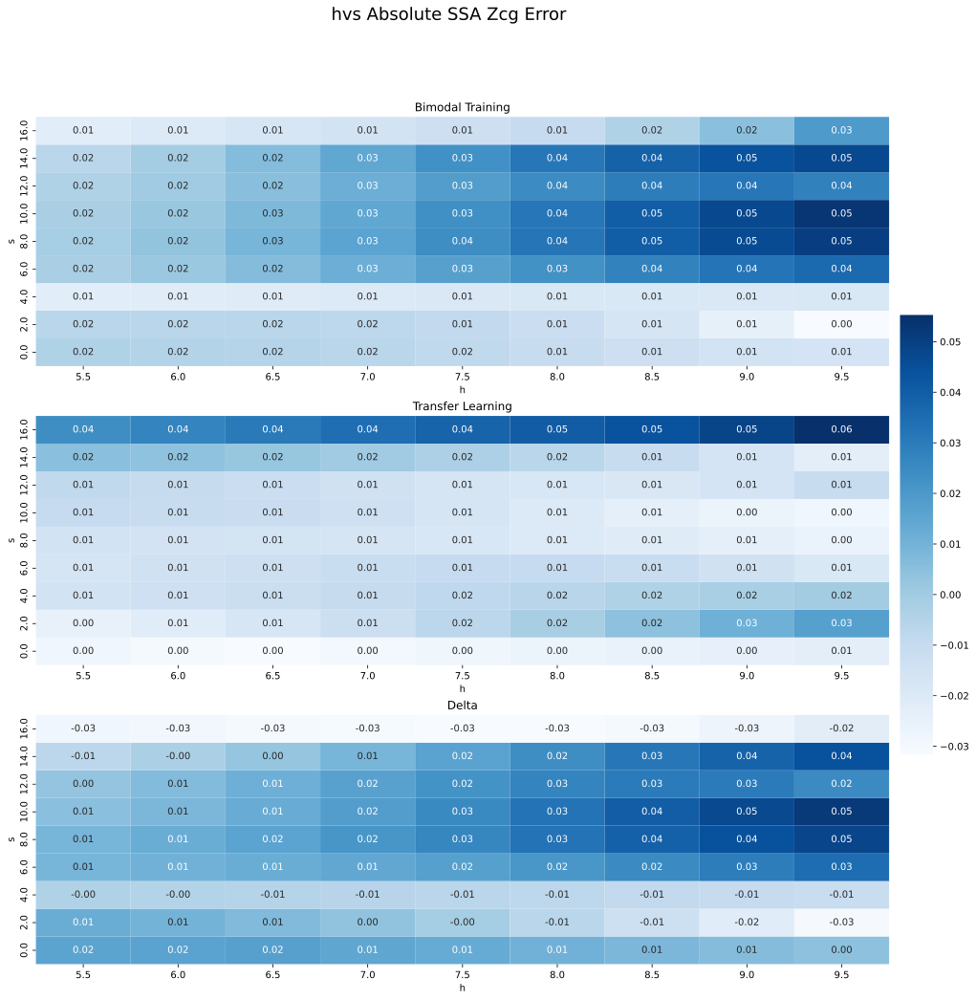

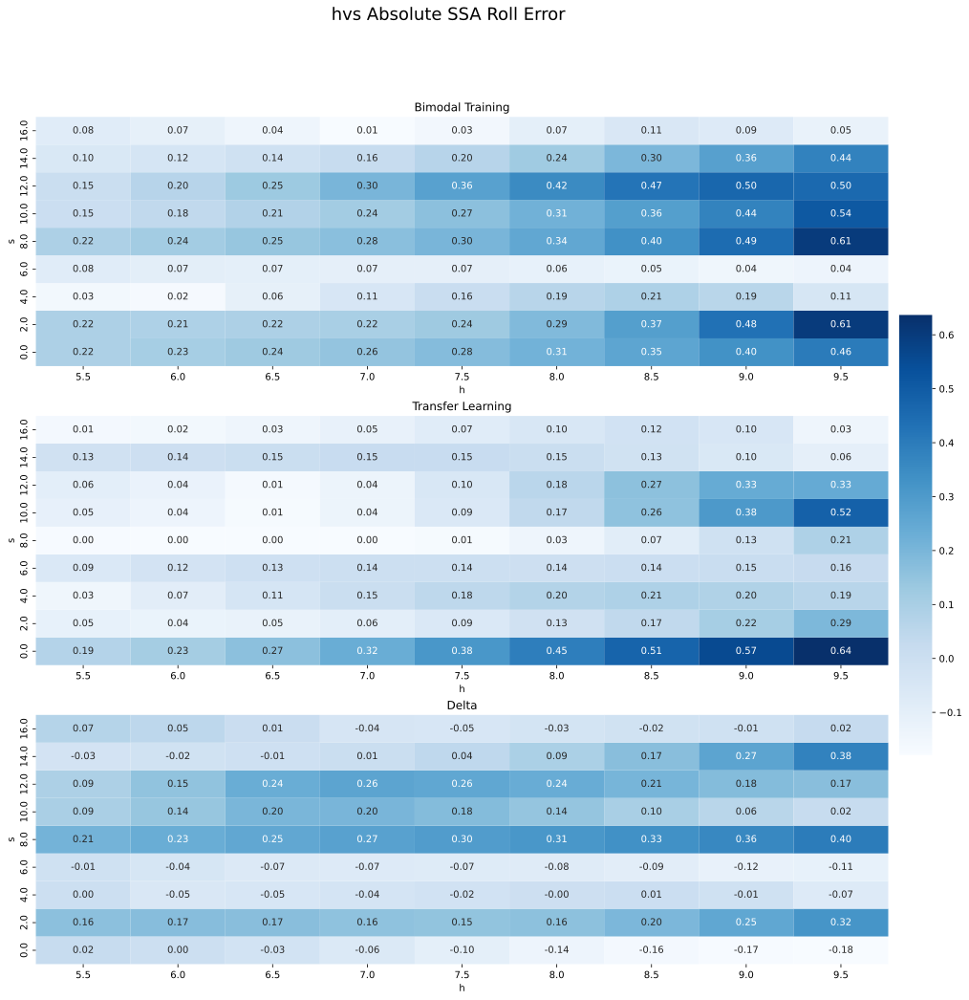

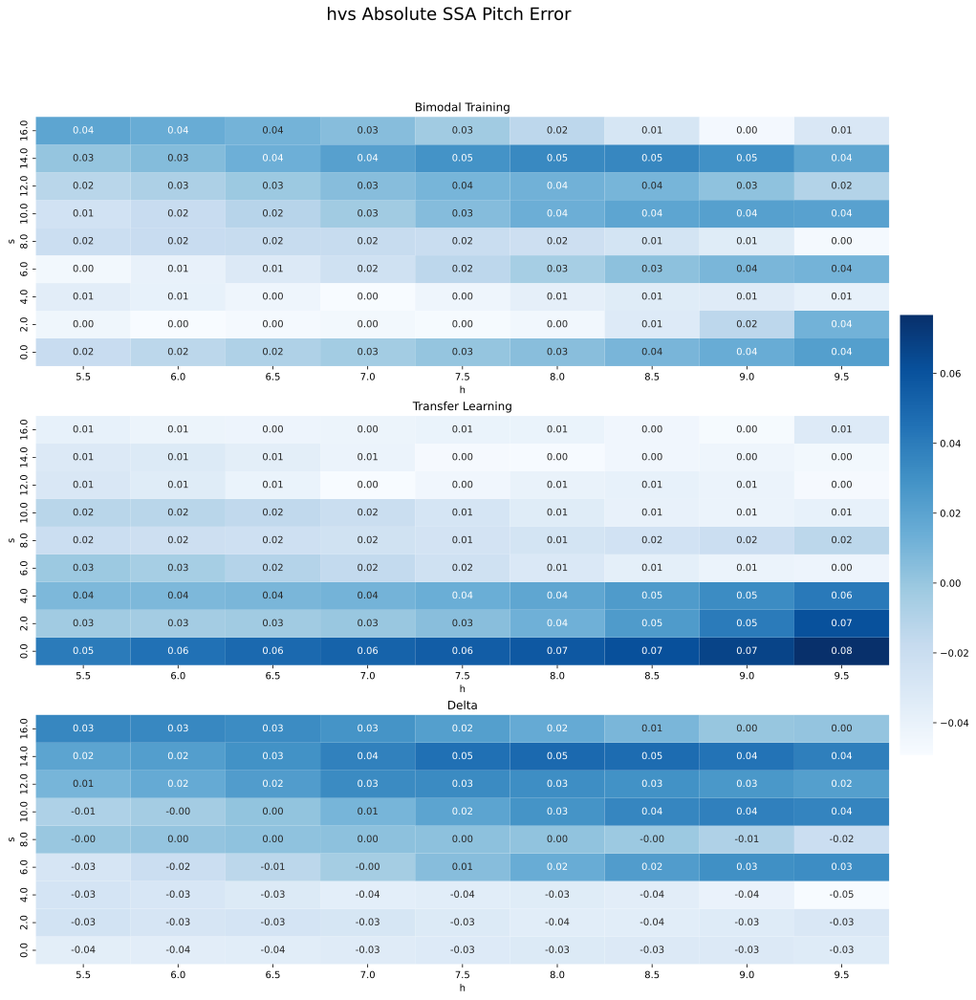

In [18]:
try:
    makeHeatmap('hvs', "Zcg Error", '3')
    makeHeatmap('hvs', "Roll Error", '3')
    makeHeatmap('hvs', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())

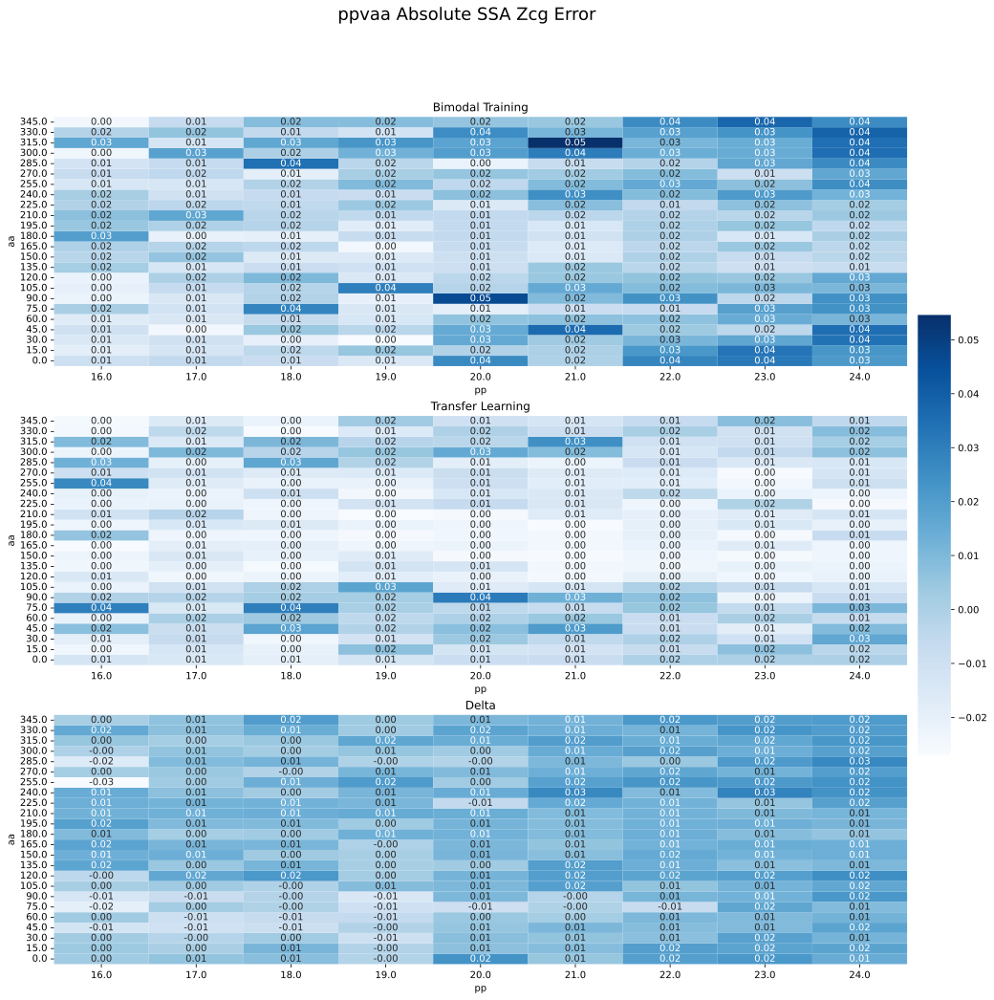

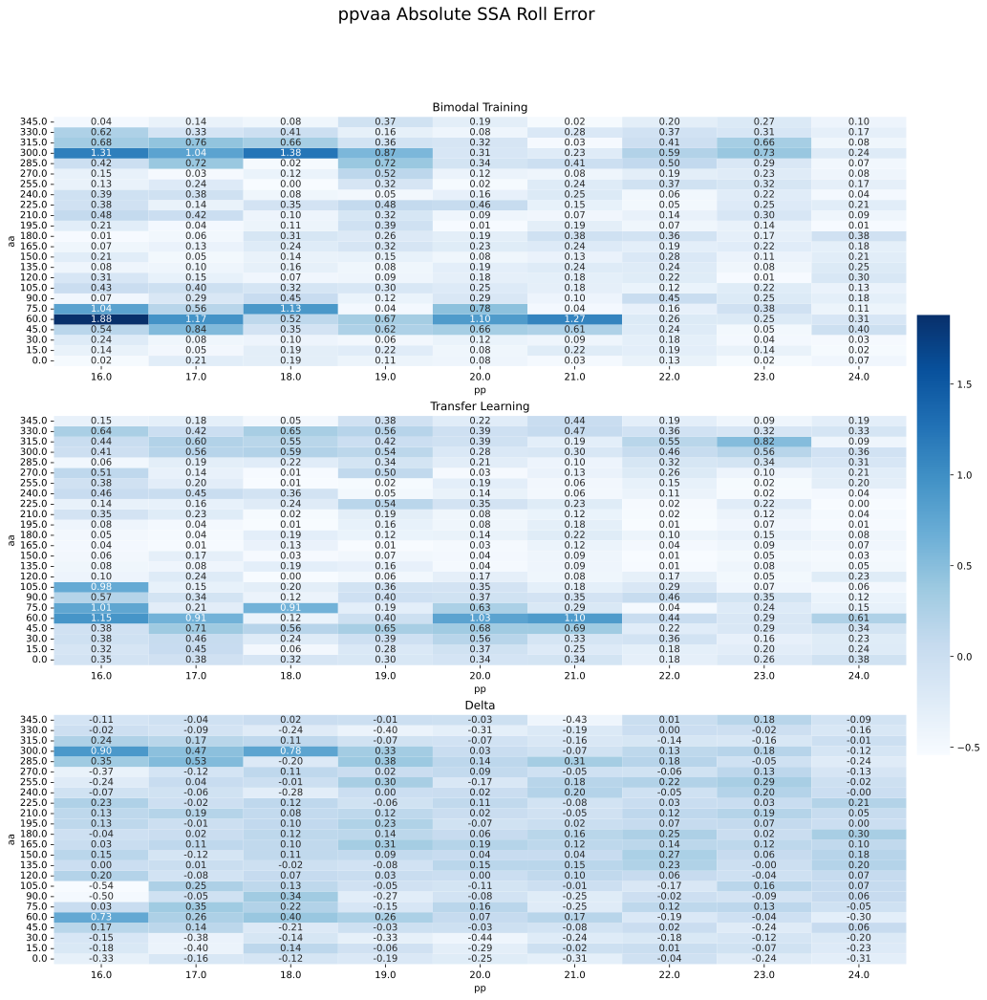

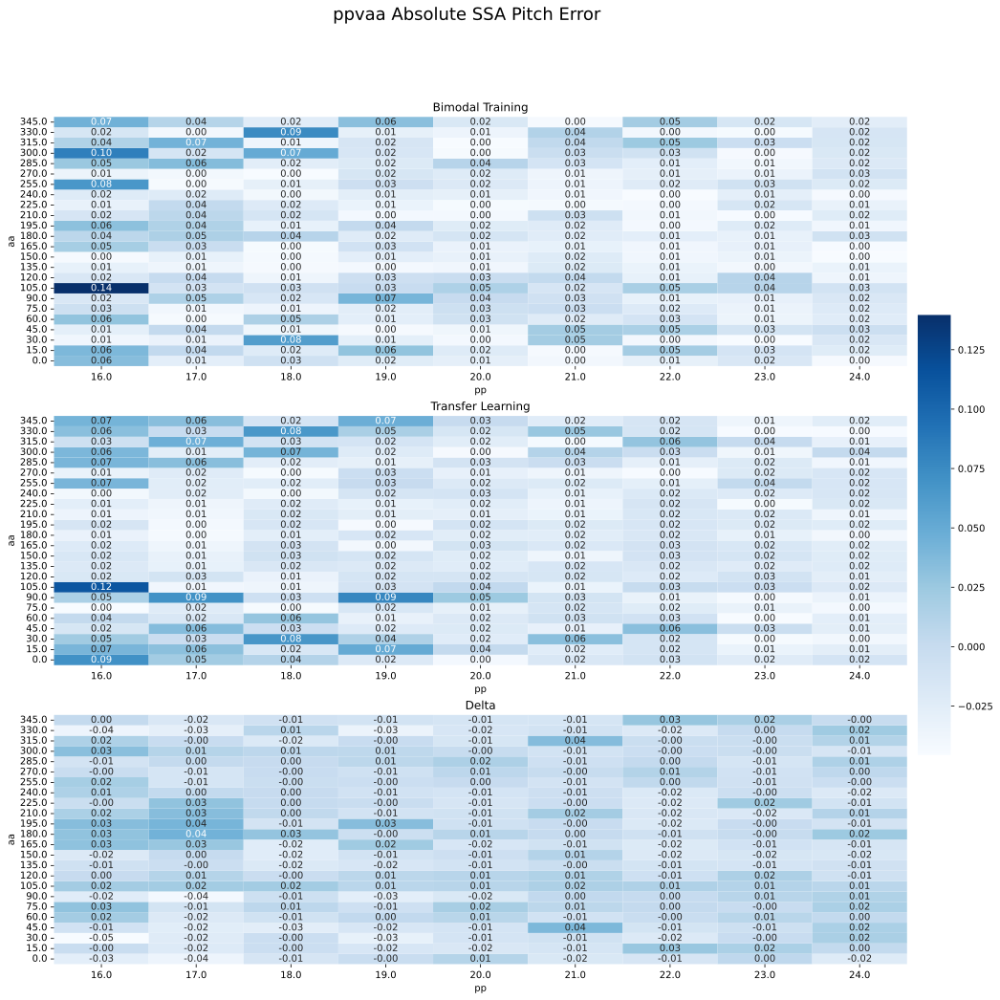

In [19]:
try:
    makeHeatmap('ppvaa', "Zcg Error", '3')
    makeHeatmap('ppvaa', "Roll Error", '3')
    makeHeatmap('ppvaa', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())

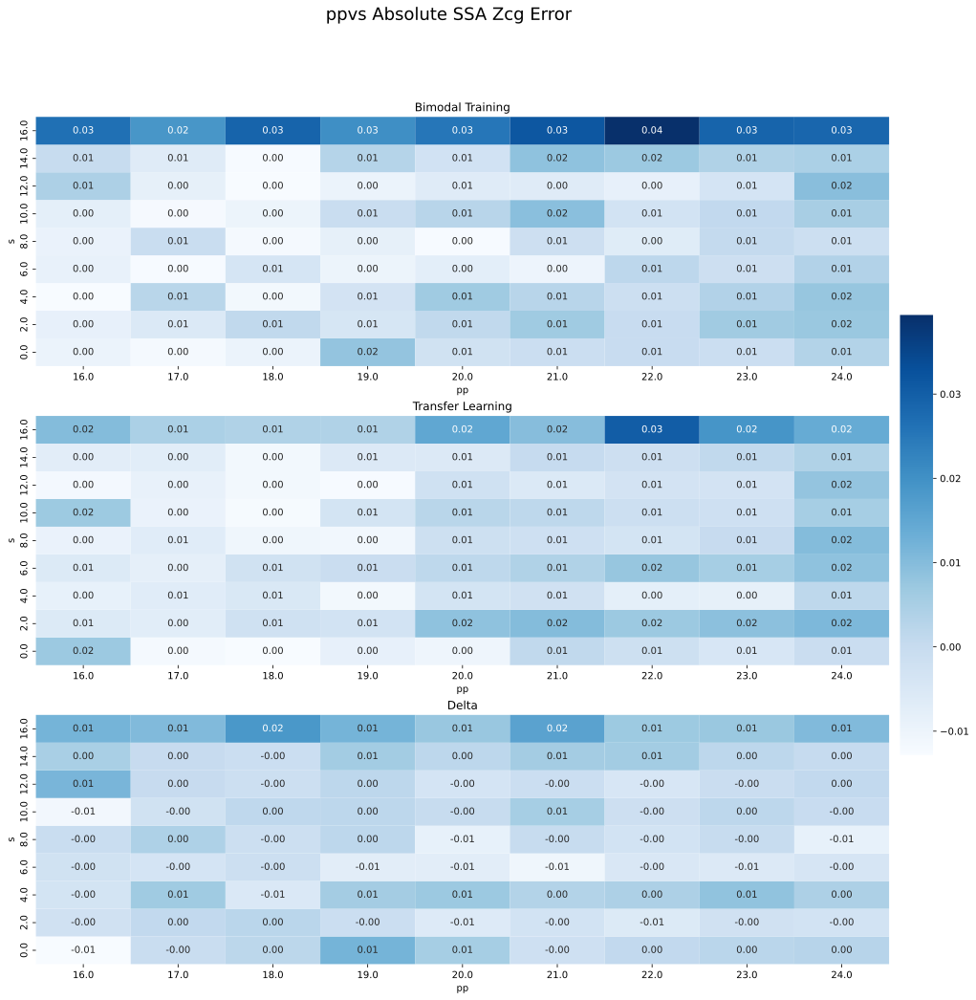

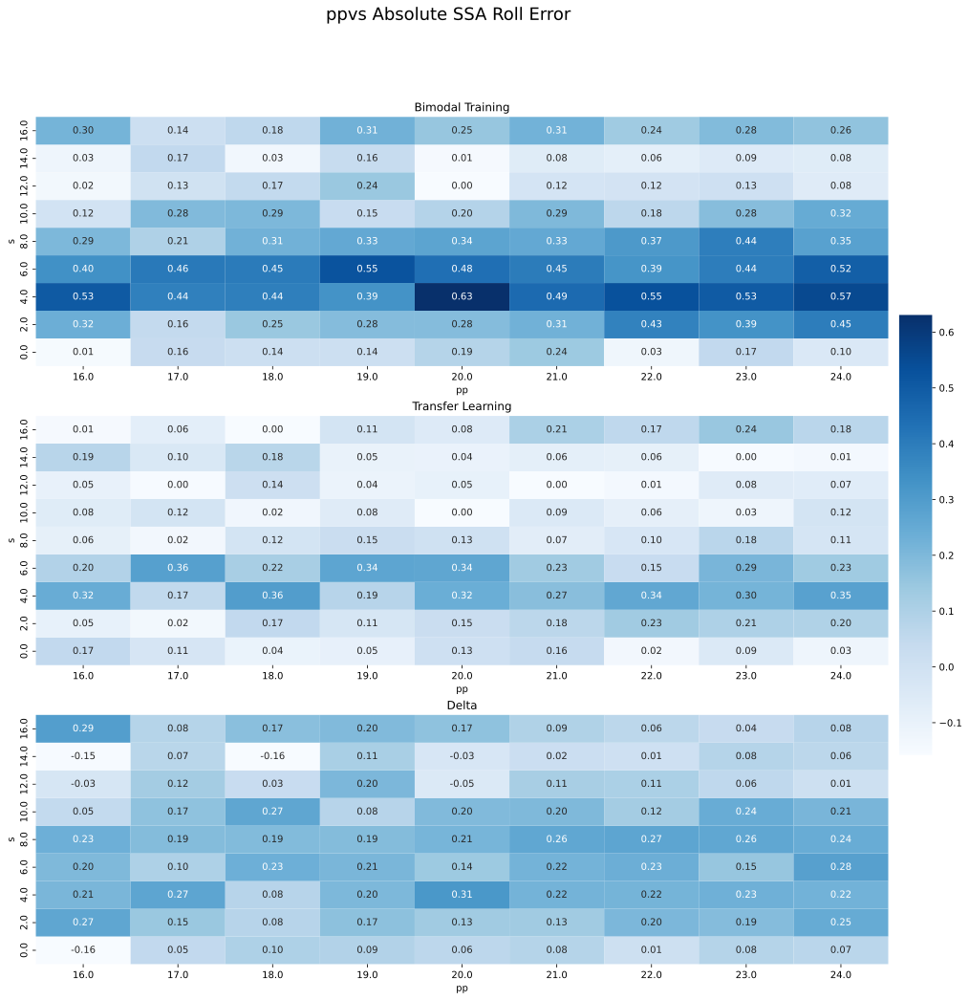

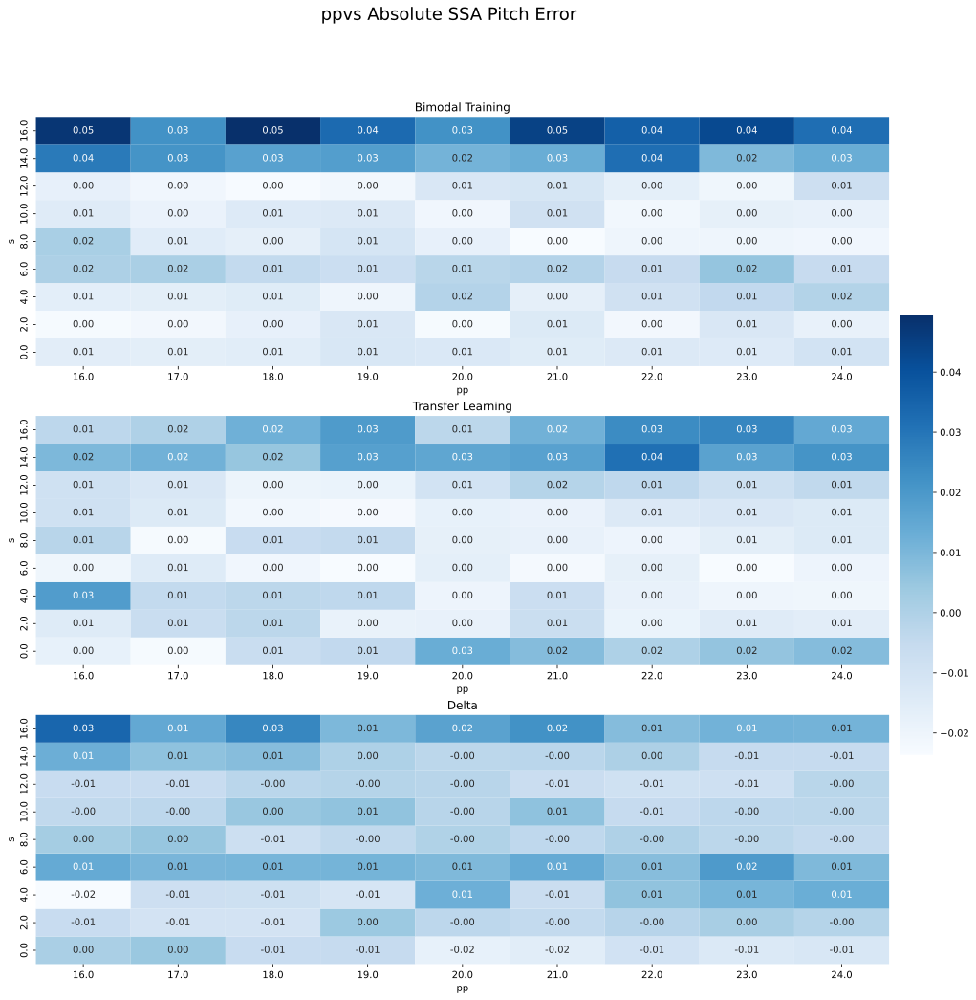

In [20]:
try:
    makeHeatmap('ppvs', "Zcg Error", '3')
    makeHeatmap('ppvs', "Roll Error", '3')
    makeHeatmap('ppvs', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())

ERROR:root:Traceback (most recent call last):
  File "C:\Users\jarod\AppData\Local\Temp\ipykernel_27948\2757619825.py", line 2, in <module>
    makeHeatmap('pva', "Zcg Error", '3')
  File "C:\Users\jarod\AppData\Local\Temp\ipykernel_27948\333675488.py", line 27, in makeHeatmap
    resulto = dfo.pivot(index=v2, columns=v1, values=parameter)
  File "h:\OneDrive - Massachusetts Institute of Technology\Thesis\SimpleCode_to_LAMP_LSTM\venv\lib\site-packages\pandas\core\frame.py", line 7885, in pivot
    return pivot(self, index=index, columns=columns, values=values)
  File "h:\OneDrive - Massachusetts Institute of Technology\Thesis\SimpleCode_to_LAMP_LSTM\venv\lib\site-packages\pandas\core\reshape\pivot.py", line 520, in pivot
    return indexed.unstack(columns_listlike)
  File "h:\OneDrive - Massachusetts Institute of Technology\Thesis\SimpleCode_to_LAMP_LSTM\venv\lib\site-packages\pandas\core\series.py", line 4157, in unstack
    return unstack(self, level, fill_value)
  File "h:\OneDrive 

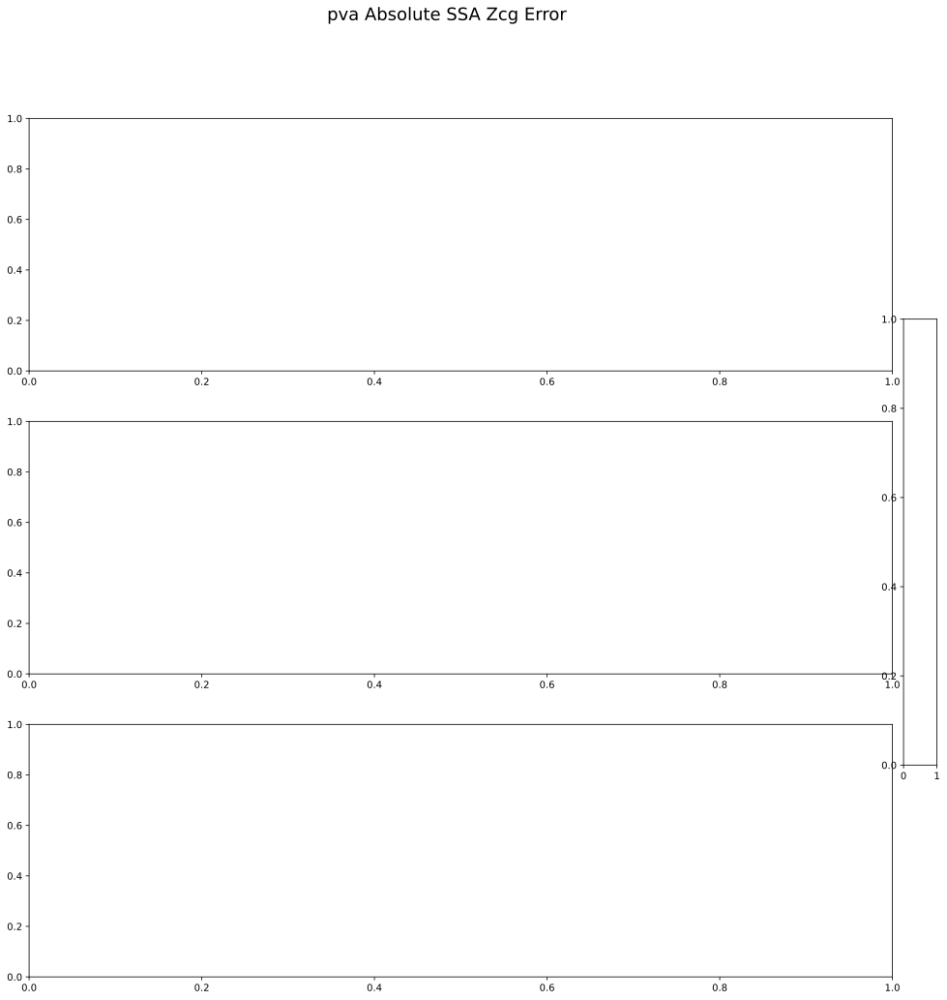

In [21]:
try:
    makeHeatmap('pva', "Zcg Error", '3')
    makeHeatmap('pva', "Roll Error", '3')
    makeHeatmap('pva', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())

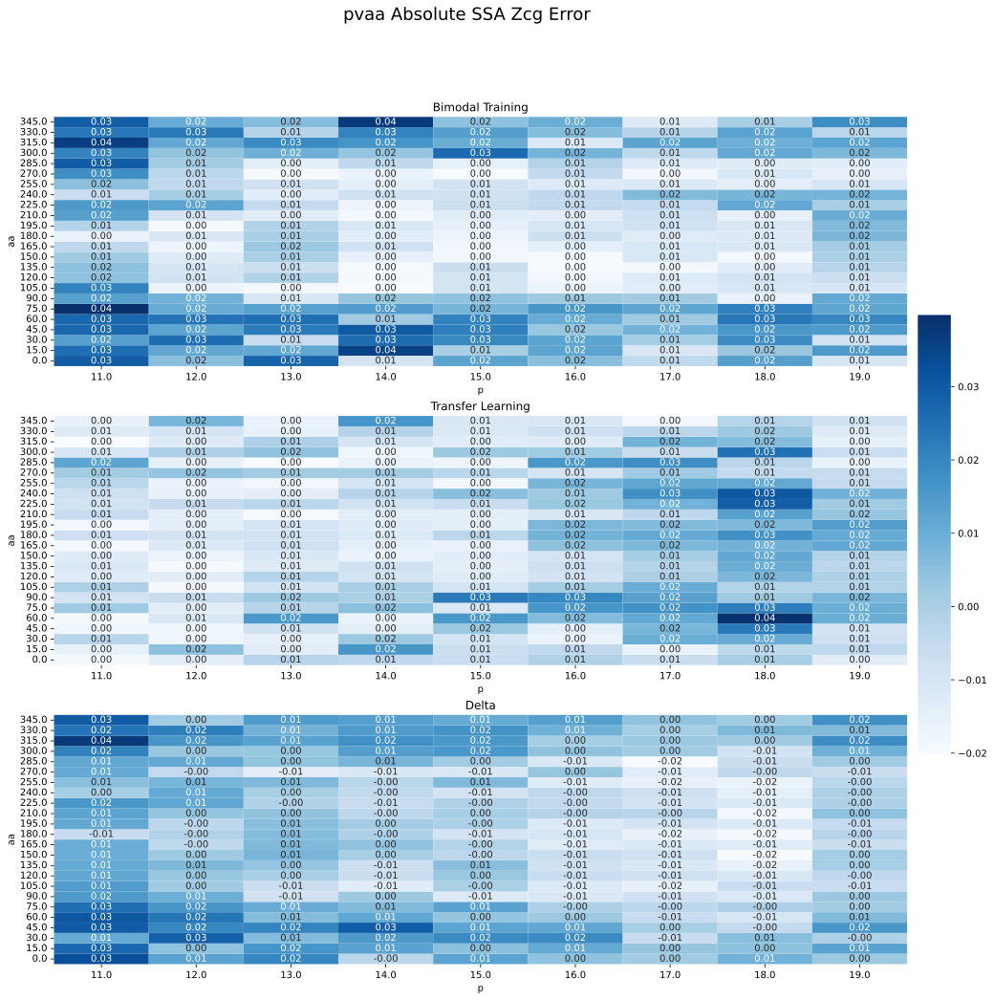

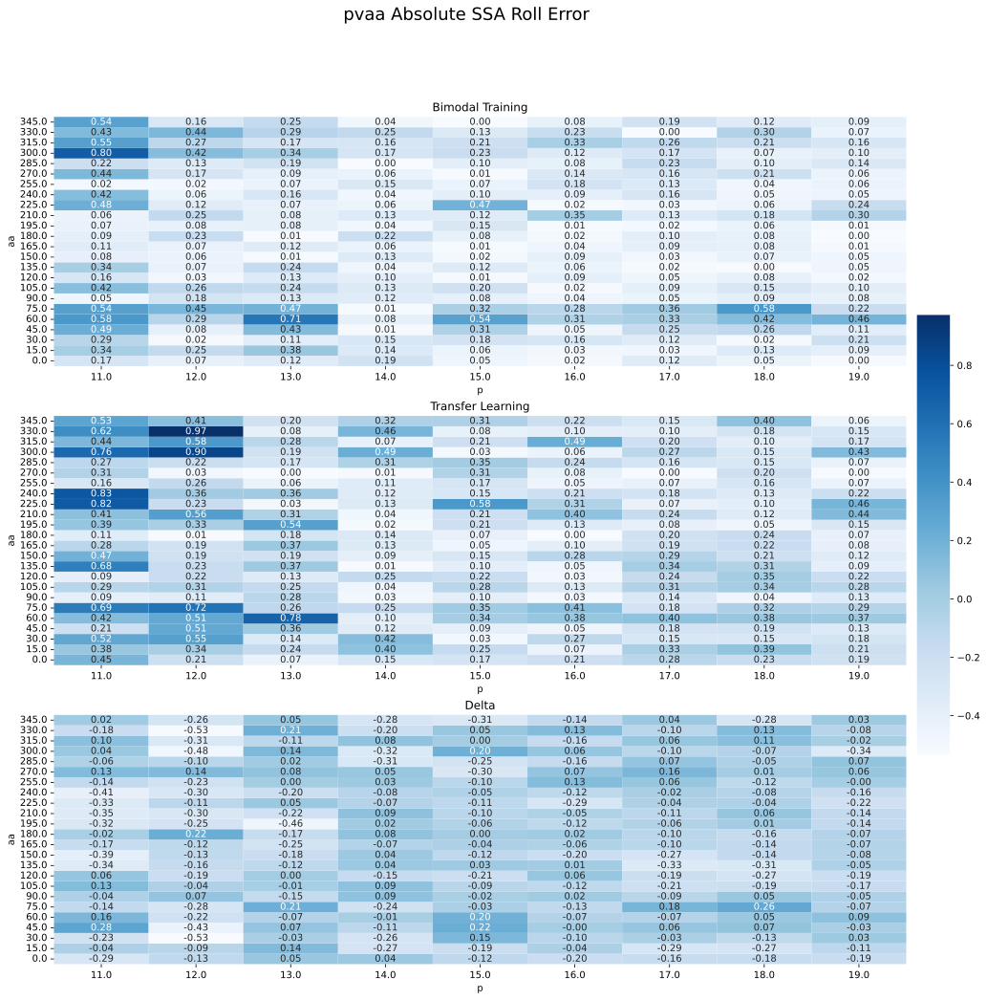

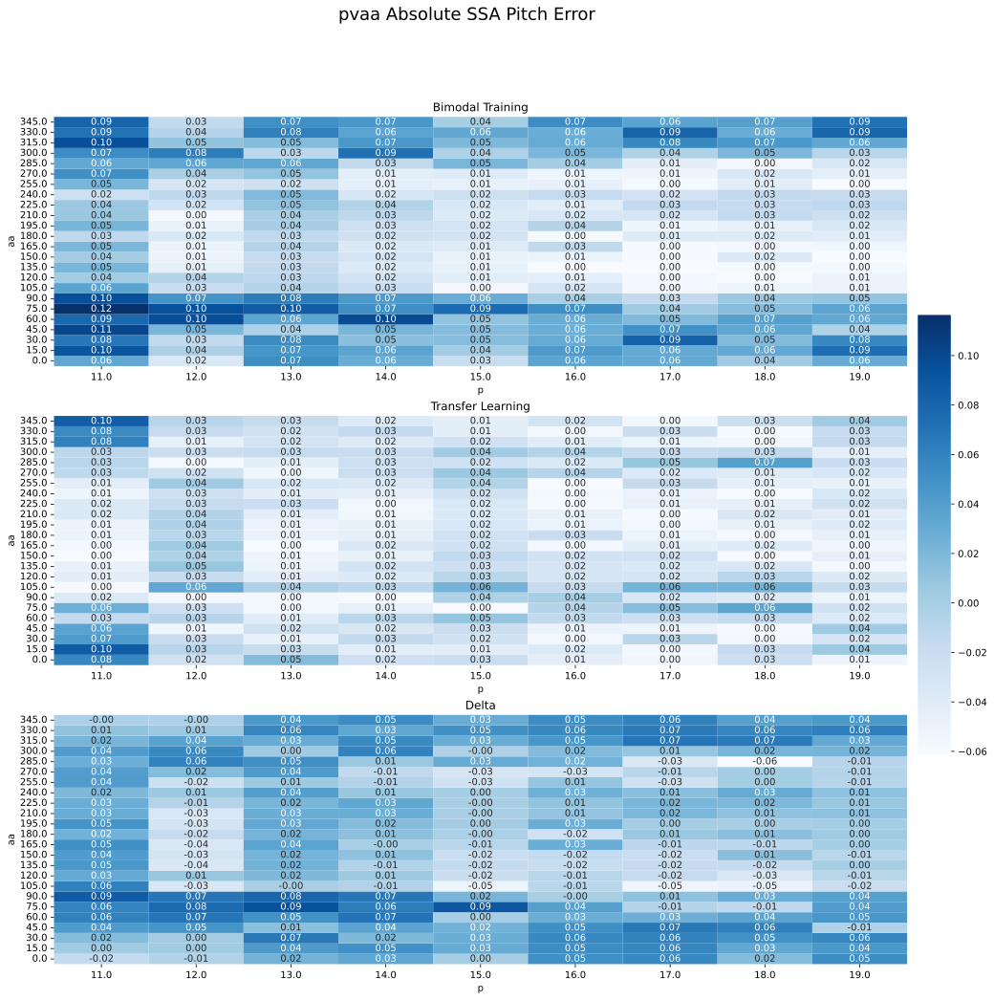

In [22]:
try:
    makeHeatmap('pvaa', "Zcg Error", '3')
    makeHeatmap('pvaa', "Roll Error", '3')
    makeHeatmap('pvaa', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())

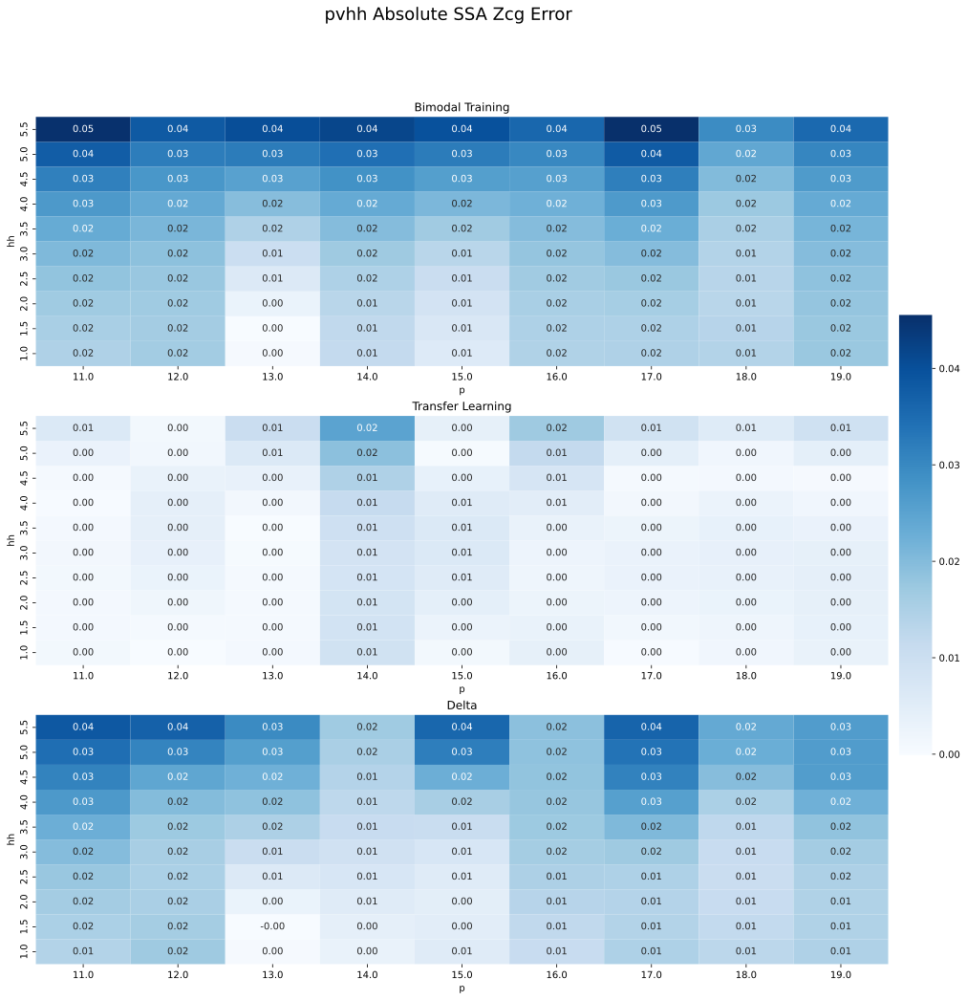

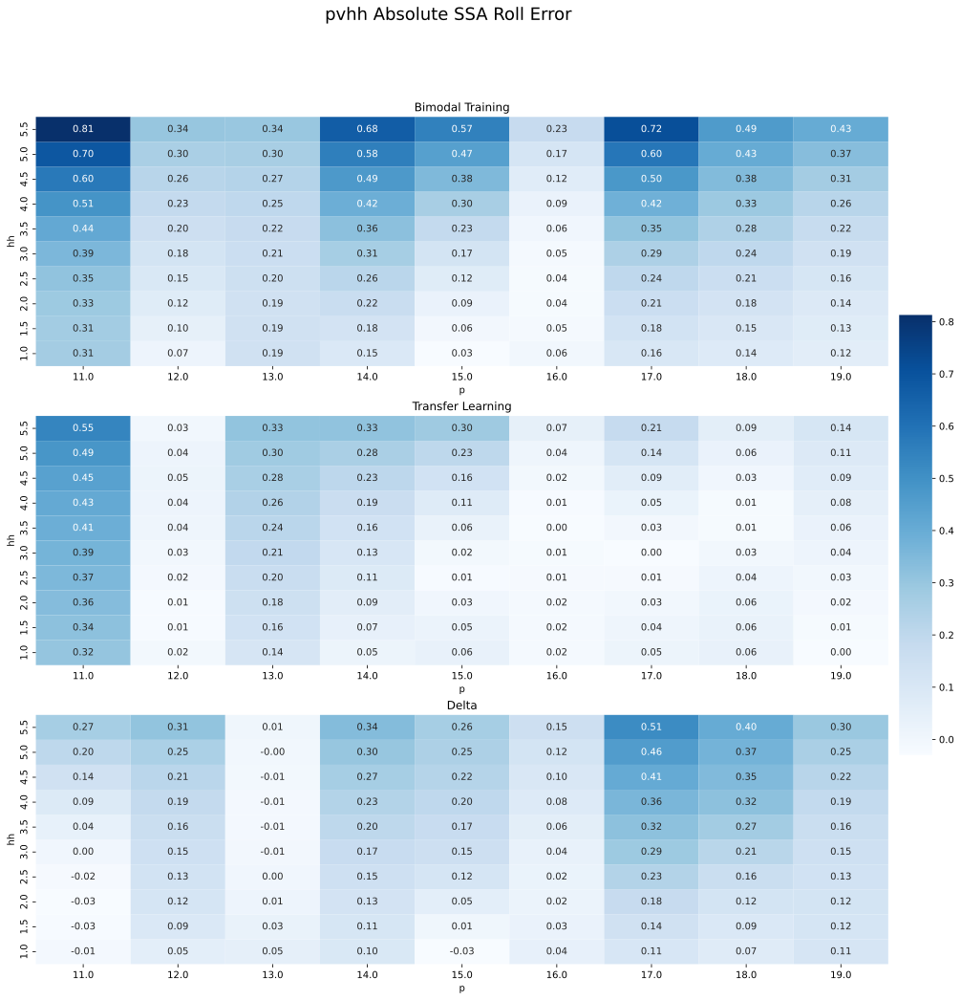

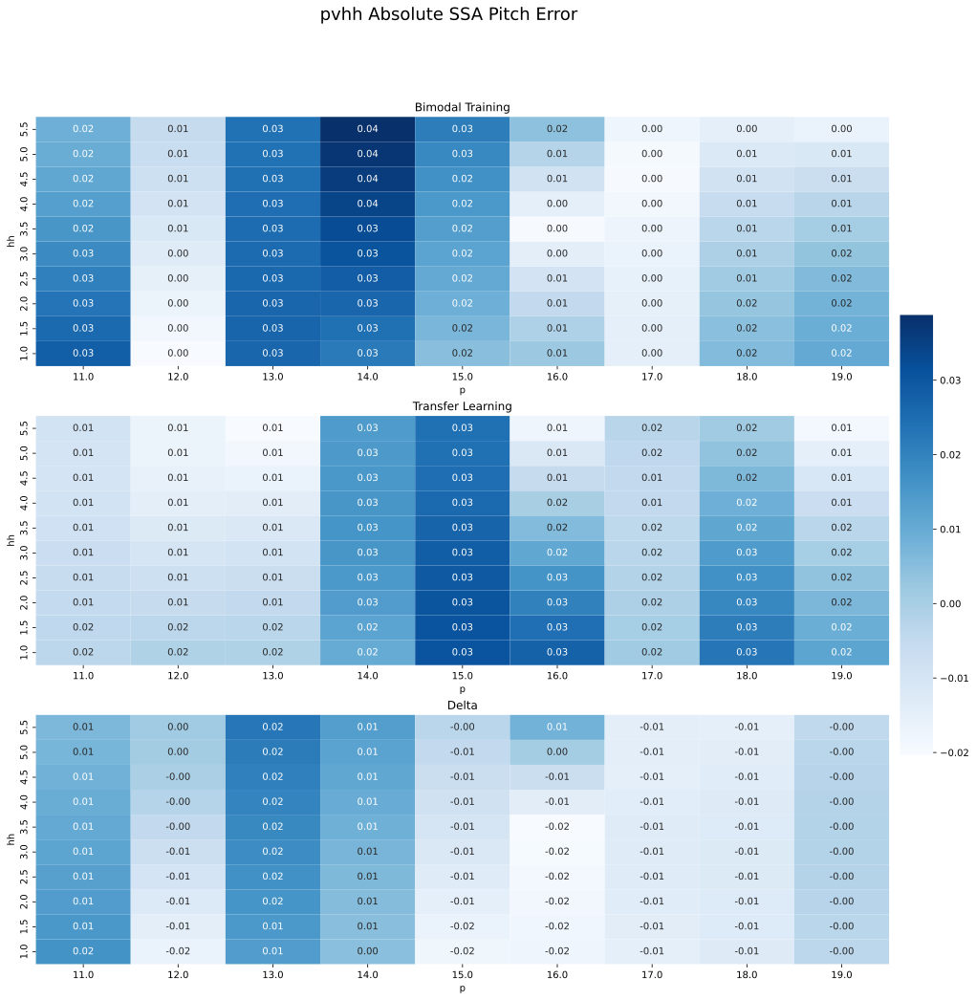

In [23]:
try:
    makeHeatmap('pvhh', "Zcg Error", '3')
    makeHeatmap('pvhh', "Roll Error", '3')
    makeHeatmap('pvhh', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())

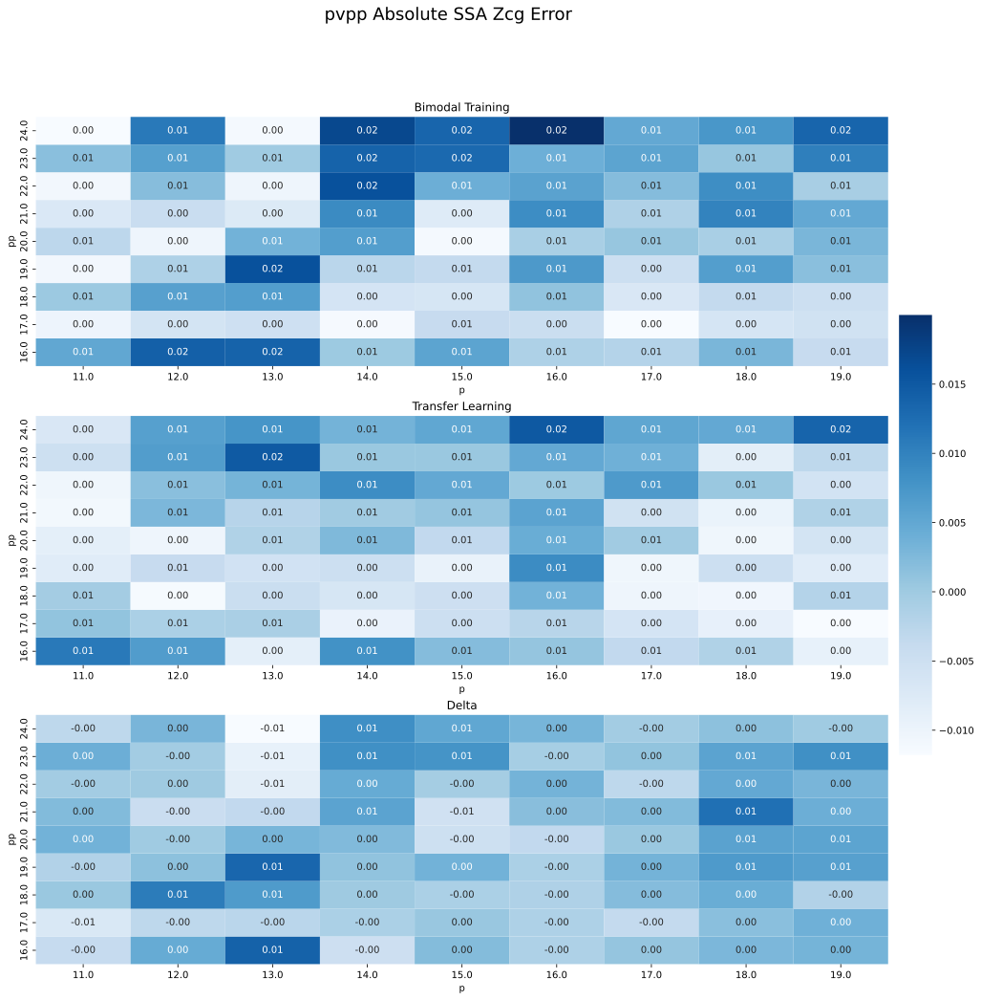

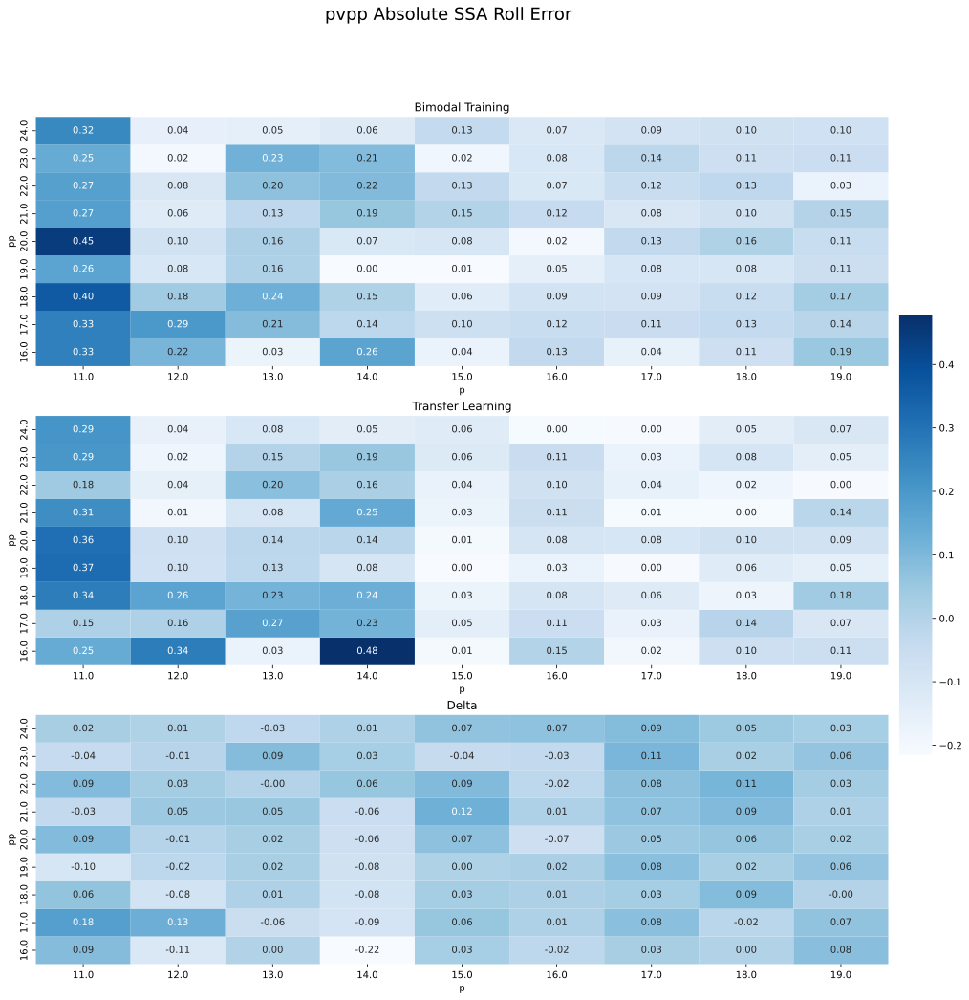

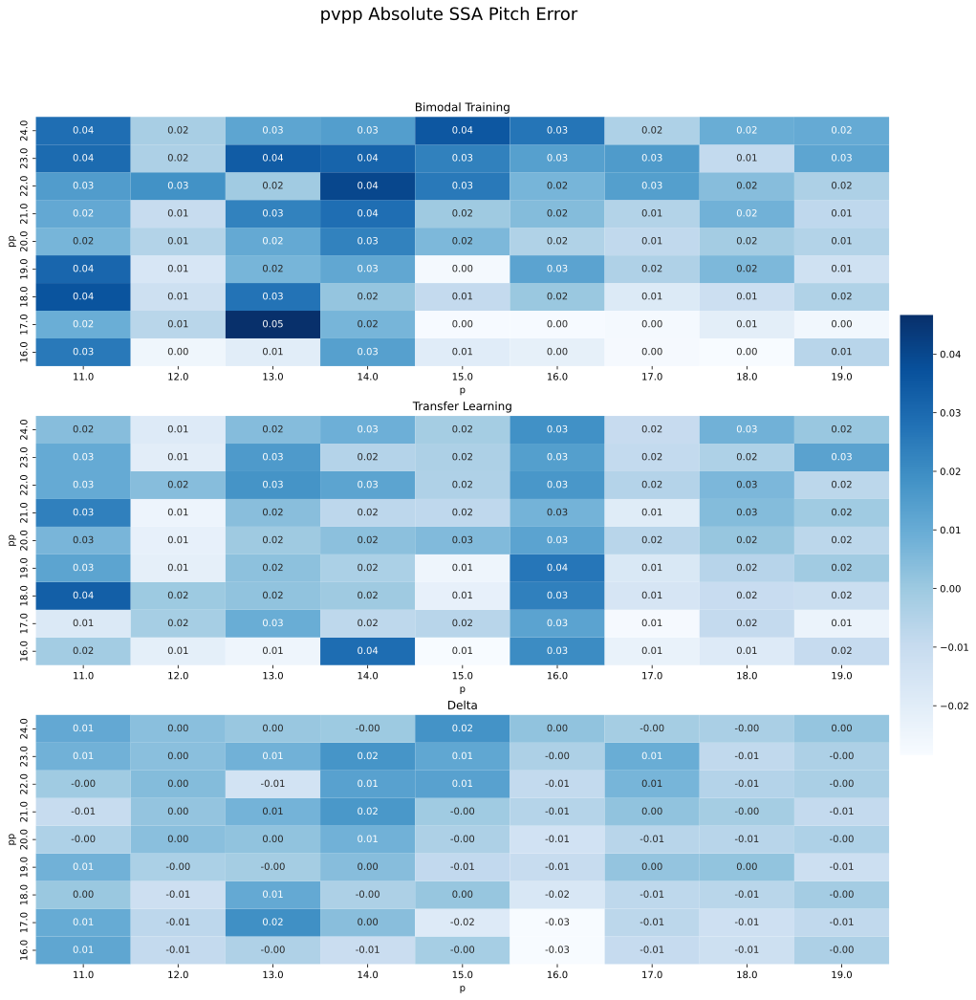

In [24]:
try:
    makeHeatmap('pvpp', "Zcg Error", '3')
    makeHeatmap('pvpp', "Roll Error", '3')
    makeHeatmap('pvpp', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())

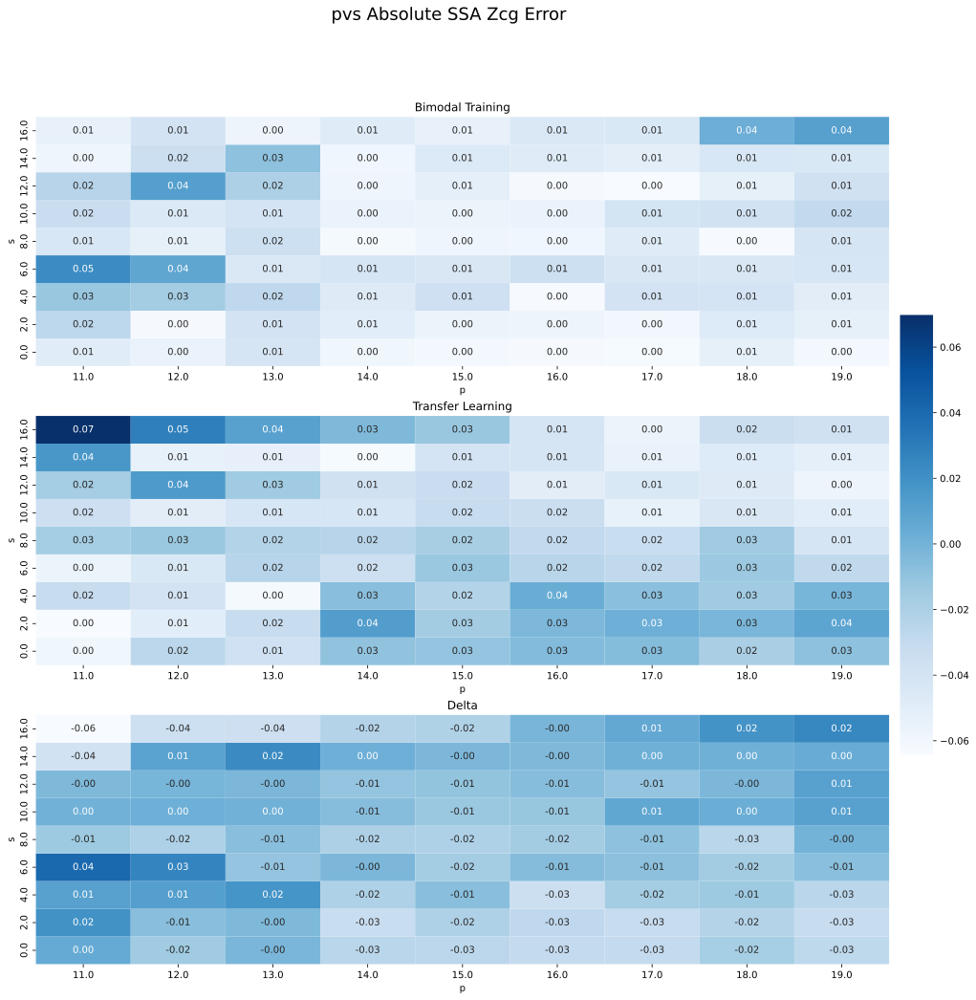

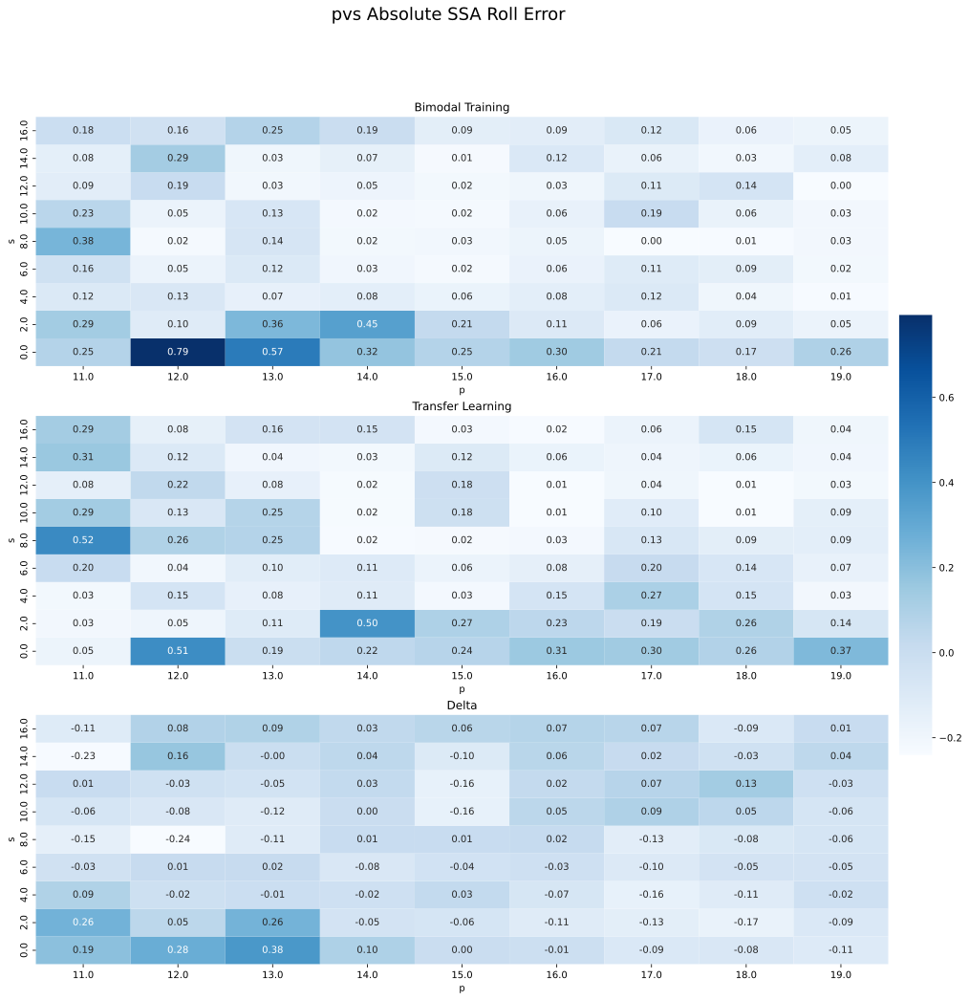

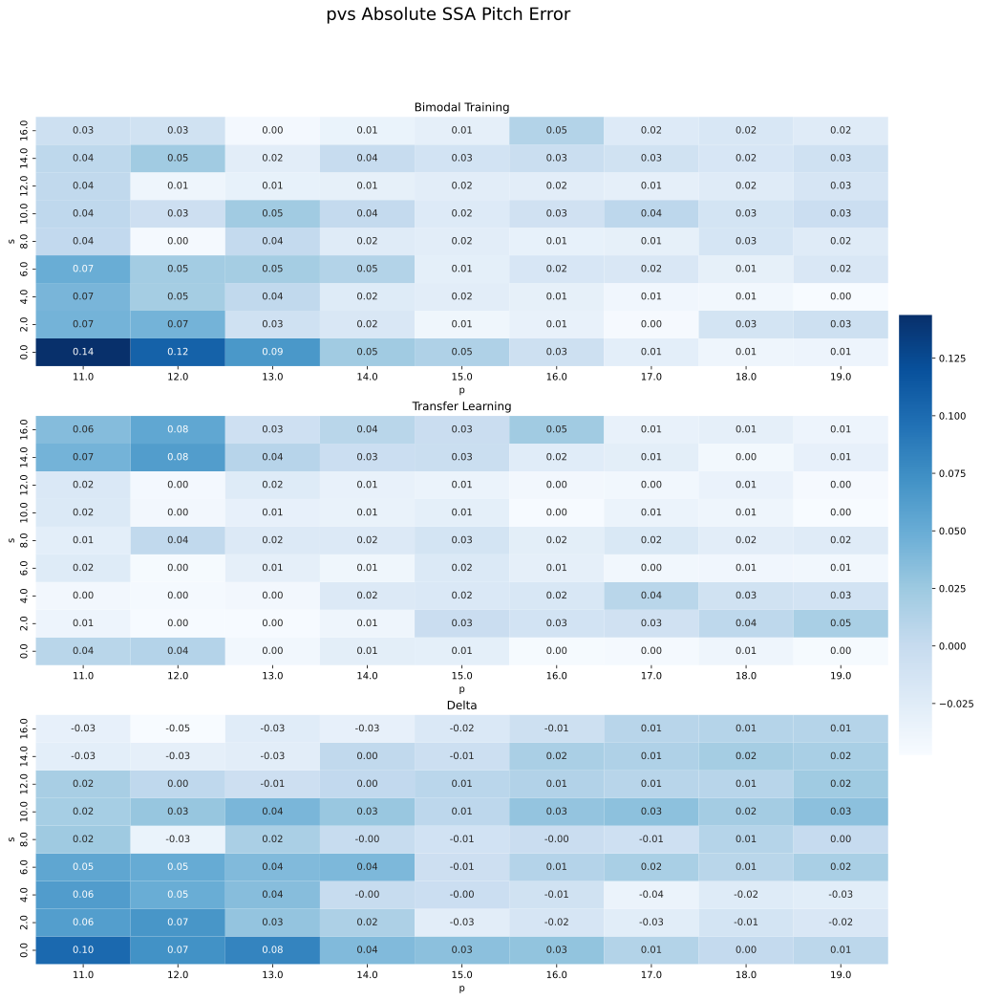

In [25]:
try:
    makeHeatmap('pvs', "Zcg Error", '3')
    makeHeatmap('pvs', "Roll Error", '3')
    makeHeatmap('pvs', "Pitch Error", '3')
except Exception as e:
    logging.error(traceback.format_exc())